In [1]:
import sys
sys.path.append("../../")

import os
import numpy as np

In [2]:
from cellmating.io import imread, imsave
from cellmating.sort import Tracker
from tqdm import trange
from cellmating.utils import load_from_pkl, dump_to_pkl
import matplotlib.pyplot as plt
import pandas as pd
from cellmating.colormap import COLOR_BlackPink
from cellmating.cells import create_cells_from_image_for_patch

from cellmating.patch import Singal, ked_fit, DynamicPatch, patch_neighbor_distance_feature
from cellmating.io import imread, imsave
from cellmating.utils import file_traverse
from cellmating.cells import create_cells_from_image_for_patch

In [3]:
from cellmating.utils import file_traverse

In [4]:
file_list = file_traverse("/media/wd/T7/data/dynamic/20230828/", file_regular='.*._rigid.tif$')

In [124]:
for i in trange(0, len(file_list)):
    file_name = file_list[i]
    image = imread(file_list[i])
    image = np.moveaxis(image, -1, 1)

    a = Tracker(image[:,-1], low_ratio=0.5, high_ratio=1.75)
    _ = a()

    new_image = np.zeros((image.shape[0], 5, image.shape[2], image.shape[3]),dtype=np.uint16)
    # new_image = np.zeros((image.shape),dtype=np.uint16)
    new_image[:,0:4] = image[:,0:4]
    new_image[:,4] = a.to_image()
    
    new_name = file_name[:-10]+".tif"
    imsave(new_name, new_image, imagej=True)
    dump_to_pkl(a.network, new_name[:-4]+".network")
    dump_to_pkl(a.trackers, new_name[:-4]+".tracker")

  0%|                                                                                                                                  | 0/1 [00:00<?, ?it/s]


FileNotFoundError: [Errno 2] No such file or directory: '/media/wd/T7/data/dynamic/20230828'

#### 1. merge 2 hours and ON data into one image

In [125]:
root = "/home/wlli/Data/dynamic/20230828/tif/"
save_root = "/home/wlli/Data/dynamic/20230828/merge/"
file_list = file_traverse(root, file_regular=r".*001.*.tif$")

In [126]:
for i in trange(0, len(file_list)):
    ep_001 = file_list[i]
    ep_002 = ep_001.replace("001", "002")
    if os.path.exists(ep_001) & os.path.exists(ep_002):
        basename = os.path.basename(ep_001).replace("001", "merge")
        image_001 = imread(ep_001).astype("uint16")
        image_002 = imread(ep_002).astype("uint16")
        image = np.concatenate([image_001, image_002])
        imsave(os.path.join(save_root, basename), image, dtype="uint16")
    else:
        print(i, ":", ep_001)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 34.19it/s]

0 : /home/wlli/Data/dynamic/20230828/tif


#### 2. segmentation

In [31]:
sys.path.append("../../deepYeast/deeplab/")
import yaml
from config_yml import ExperimentOptions
from trainer.train import DeepCellModule
from postprocess.post_process_utils import post_process_panoptic


mode = 'test' #train, evl, test
model_dir = "/home/wd/data/deepyeastmodel/v_1.0.0/checkpoint/"
train_dir = "/home/wd/data/deepyeastmodel/v_1.0.0/tf/train*.tfrecord"
eval_dir = "/home/wd/data/deepyeastmodel/v_1.0.0/tf/val*.tfrecord"
config_path = "../../deepYeast/deeplab/configs/config_wl.yaml"
num_gpus = 1

In [32]:
with open(config_path, 'r') as f:
    config = yaml.load(f, Loader=yaml.FullLoader)
configs = ExperimentOptions(config)
configs.model_options.backbone.drop_path_keep_prob=1
configs.train_dataset_options.file_pattern=train_dir
configs.eval_dataset_options.file_pattern=eval_dir

cellmodel = DeepCellModule(mode, configs, num_gpus, model_dir=model_dir)

2023-09-08 18:58:38.942553: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-09-08 18:58:39.196311: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-09-08 18:58:39.196775: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-09-08 18:58:39.198363: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

/home/wd/data/deepyeastmodel/v_1.0.0/checkpoint/
restoring or initializing model...
restored model from /home/wd/data/deepyeastmodel/v_1.0.0/checkpoint/ckpt-100000.
restored from checkpoint: /home/wd/data/deepyeastmodel/v_1.0.0/checkpoint/ckpt-100000


In [33]:
root = "/media/wd/T7/data/20230828/"
file_list = file_traverse(root, file_regular=r".*/merge/.*.tif$")

In [34]:
for i in trange(0, 1):
    filename = file_list[i]
    img = imread(filename)[:,:,:,0:3]
    ## segmentation
    if (img.ndim == 4) & (img.shape[3] == 3):
        segmentation = np.zeros(img.shape[0:3], dtype="uint16")
        for f in range(0, img.shape[0]):
            print('\r', '|'+'*'*int(f/img.shape[0]*10)+' '*int((1-f/img.shape[0])*10)+'|'+str(f)+"/"+str(img.shape[0]),end=' ')
            output = cellmodel.predict(img[f, :, :, 0])
            post_ouput = output["panoptic_pred"][0].numpy()
            post_ouput = post_process_panoptic(post_ouput)
            segmentation[f] = post_ouput.astype("uint16")
        concatenate = np.concatenate((img, np.expand_dims(segmentation, axis=3)),axis=3)
        # imsave(os.path.join(root, "segmentation", os.path.basename(filename)[:-4]+"_seg.tif"), segmentation, dtype=np.uint16)
        imsave(filename, concatenate, dtype=np.uint16)

  0%|                                                                                                                                                                                | 0/1 [00:00<?, ?it/s]

 |          |0/266 

2023-09-08 18:58:56.269069: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8600
2023-09-08 18:59:10.141331: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 3 does not match size of permutation 4 @ fanin shape inwhile/body/_1/while/SelectV2_1-1-TransposeNHWCToNCHW-LayoutOptimizer


 |*********|265/266  

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [13:34<00:00, 814.14s/it]


#### 3. tracing

In [4]:
# import sys
# sys.path.append("../../deepYeast/")
# sys.path.append("../../")

from cellmating.sort import tracing
from cellmating.cells import clean_traced_image
import matplotlib.pyplot as plt

In [5]:
def run_single_sample(img_all):
    output_d, traced_image = tracing(img_all,max_age=5, min_hits=0, iou_threshold=0.5, area_threshold=0.7)
    traced_image_cleaned = clean_traced_image(traced_image)
    # img_all = np.concatenate((img_all, np.expand_dims(traced_image_cleaned, axis=3)), axis=3).astype(np.uint16)
    return traced_image_cleaned

In [6]:
root = "/media/wd/T7/data/20230828/"
file_list = file_traverse(root, file_regular=r".*/merge/.*.tif$")

In [8]:
for i in trange(0, 1):
    ## load path
    filename = file_list[i]
    img = imread(filename)[:,:,:,3].astype("uint16")
    ## tracing
    merged_data = run_single_sample(img)
    ## save
    imsave(os.path.join(root, "traced", os.path.basename(filename)[:-7]+"trc.tif"), merged_data, dtype=np.uint16)

  0%|                                                                                                                                                                                | 0/1 [00:00<?, ?it/s]/home/wd/project/cellmating/run/../../cellmating/cells/_utils.py:19: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  cell_feature_list[j].loc[i] = maskobj.instance_property(label=j)[1:]
/home/wd/project/cellmating/run/../../cellmating/cells/_utils.py:19: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  cell_feature_list[j].loc[i] = maskobj.instance_property(label=j)[1:]
/home/wd/project/cellmating/run/../../cellmating/cells/_utils.py:19: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in 

#### 4. merge channels

In [4]:
root = "/media/wd/T7/data/20230828/"
file_list = file_traverse(root, file_regular=r".*/merge/.*.tif$")

In [5]:
for i in trange(0, 1):
    filename = file_list[i]
    trac_name = filename.replace("/merge/", "/traced/")[:-4]+"_trc.tif"
    merge_image = imread(filename)
    if merge_image.shape[3] > 4:
        merge_image = merge_image[:,:,:,[0,1,2,3,4]]
    trac_image = imread(trac_name)
    merge_image = np.concatenate((merge_image, np.expand_dims(trac_image, axis=3)), axis=3).astype(np.uint16)
    imsave(filename, merge_image)

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:28<00:00, 28.67s/it]


#### 5. crop images

In [5]:
from cellmating.image_measure import ImageMeasure
from cellmating.utils import crop_coordinate_range
%load_ext autoreload
%autoreload 2

In [4]:
root = "/media/wd/T7/data/dynamic/20230828/"
file_list = file_traverse(root, file_regular=r".*/merge/.*.[^(rigid)].tif$")

In [579]:
i=1
filename = file_list[i]
image = imread(filename)
frame = 0
mask = image[frame,4]
measure = ImageMeasure(mask)
targest = measure.property_table.loc[measure.property_table.is_out_of_border==0]

In [584]:
for i in trange(0, len(file_list)):
    filename = file_list[i]
    image = imread(filename)
    frame = 0
    mask = image[frame,4]
    measure = ImageMeasure(mask)
    targest = measure.property_table.loc[measure.property_table.is_out_of_border==0]
    
    for j in range(0, targest.shape[0]):
        data = targest.iloc[j]
        neibor = measure.neighbor(data.name, targets=targest.index)
        coords = measure.coordinates(index=neibor+[data.name])
        x_max = int(coords[:,:,0].max())
        x_min = int(coords[:,:,0].min())
        y_max = int(coords[:,:,1].max())
        y_min = int(coords[:,:,1].min())
        croped_image = image[:,:,x_min:x_max, y_min:y_max]

        # data = targest.iloc[j]
        # neibor = measure.neighbor(data.name, targets=targest.index)
        # coords = np.array(list(neibor.coords))
        # x_max = int(coords[:,0,:].max())
        # x_min = int(coords[:,0,:].min())
        # y_max = int(coords[:,1,:].max())
        # y_min = int(coords[:,1,:].min())
        # croped_image = image[:,x_min:x_max, y_min:y_max,:]
        croped_name = filename[:-4]+f"_f_{frame:04}_id_{data.label:04}.tif"
        croped_name = croped_name.replace("/merge/","/crop/")
        imsave(croped_name, croped_image, dtype="uint16", imagej=True)
        
        # coords_range = crop_coordinate_range(center=center,
#                                      length=300,
#                                      v_min=0,
#                                      v_max=measure.shape[0])

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [23:05<00:00, 138.50s/it]


#### 6.run patch object and save

In [5]:
import sys
sys.path.append("../../")
import os
from tqdm import trange
import numpy as np
from cellmating.io import imread, imsave
from cellmating.cells import Cell, create_cells_from_image, create_tracker_from_image, create_cells_from_image_for_patch
from cellmating.patch import DynamicPatch
from cellmating.utils import file_traverse, dump_to_pkl, load_from_pkl

%load_ext autoreload
%autoreload 2

In [6]:
root = "/media/wd/T7/data/dynamic/20230828/"
file_list = file_traverse(root, file_regular=r".*/crop/.*[^rigid].tif$")

In [7]:
len(file_list)

575

In [12]:
all_data = []
for i in trange(0, len(file_list)):
    try:
        filename = file_list[i]
        org_label = int(filename.split("_")[-1][:-4])
        label = org_label%1000
        image = imread(filename)
        # image = np.moveaxis(image, -1, 1)
        # cells = create_tracker_from_image(image[:,-1])
        cells = create_cells_from_image_for_patch((image[:,-1]==org_label)*org_label)
        c = cells[label]

        c.tracking_mask = image[:,-1]%1000
        c.reference_image = image[:,0]
        c.fluorescence_image = image[:,1:-2]

        patch = DynamicPatch.from_cell(c)
        dump_to_pkl(patch, filename[:-4]+".pkl")

        intensity_data = patch.periphery_patch_intensity(percentile=90, channel=[0,1])
        signal_patch = Singal(data = patch.patch_intensity[:,:,0],
                              angles = patch.angle_,
                              frames = patch.frames,
                              coordinates = patch.coordinates_,
                              background = patch.background[:,0],
                              name = filename)

        steps = signal_patch.transfer_steps()
        patch_data = signal_patch._patch_features
        x, y_patch = ked_fit(patch_data[:, 7], bw_adjust=0.25)

        distance_data = patch.neighbor_distance_angle
        x, y_dist = ked_fit(distance_data[0], bw_method=0.1, weights=distance_data[1].max() - distance_data[1])

        feature = patch_neighbor_distance_feature(x ,y_patch, y_dist)
        all_data += list(feature)
    except Exception as error:
        # handle the exception
        print(i, filename, error)

  0%|                                                                                                                                                                               | 0/575 [00:00<?, ?it/s]/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/threadpoolctl.py:762: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)
  0%|▎                                                                                                                                                                    | 1/575 [00:09<1:27:36,  9.16s/it]

0 /media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1001.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
  0%|▎                                                                                                                                                                    | 1/575 [00:28<4:28:26, 28.06s/it]


KeyboardInterrupt: 

In [176]:
all_data = np.array(all_data)

In [177]:
data = pd.DataFrame(all_data, columns=["Deviation", "patch_angle", "patch_time", "neighbor_angle", "neighbor_distance","top_patch","top_neiber"])
data.to_csv("./csv/dynamic_patch_neiber_distance.csv")

In [413]:
patch_data.shape

(9, 11)

In [157]:
filename = "/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1002.tif"
org_label = int(filename.split("_")[-1][:-4])
label = org_label%1000
image = imread(filename)
# image = np.moveaxis(image, -1, 1)
# cells = create_tracker_from_image(image[:,-1])
cells = create_cells_from_image_for_patch((image[:,-1]==org_label)*org_label)
c = cells[label]

c.tracking_mask = image[:,-1]%1000
c.reference_image = image[:,0]
c.fluorescence_image = image[:,1:-2]

patch = DynamicPatch.from_cell(c)
dump_to_pkl(patch, filename[:-4]+".pkl")

intensity_data = patch.periphery_patch_intensity(percentile=90, channel=[0,1])
signal_patch = Singal(data = patch.patch_intensity[:,:,0],
                      angles = patch.angle_,
                      frames = patch.frames,
                      coordinates = patch.coordinates_,
                      background = patch.background[:,0],
                      name = filename)

/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [159]:
signal_patch = Singal(data = patch.patch_intensity[:,:,0],
                      angles = patch.angle_,
                      frames = patch.frames,
                      coordinates = patch.coordinates_,
                      background = patch.background[:,0],
                      name = filename)
# steps = signal_patch.transfer_steps()

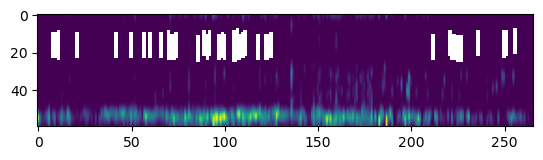

In [169]:
plt.imshow(signal_patch.smooth.T)

In [170]:
thresd = (signal_patch.smooth > 0.2)*1
sums = thresd.sum(axis=0)

In [171]:
sums

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

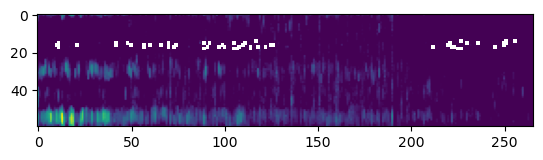

In [165]:
plt.imshow(patch.normlized_intensity[:,:,1].T)

In [132]:
steps = signal_patch.transfer_steps()
patch_data = signal_patch._patch_features
x, y_patch = ked_fit(patch_data[:, 7], bw_adjust=0.25)

distance_data = patch.neighbor_distance_angle
x, y_dist = ked_fit(distance_data[0], bw_method=0.1, weights=distance_data[1].max() - distance_data[1])

feature = patch_neighbor_distance_feature(x ,y_patch, y_dist)
all_data += list(feature)

AttributeError: 'NoneType' object has no attribute 'labels_'

In [ ]:
steps = signal_patch.transfer_steps()

patch_data = signal_patch._patch_features
x, y_patch = ked_fit(patch_data[:, 7], bw_adjust=0.25)

distance_data = patch.neighbor_distance_angle
x, y_dist = ked_fit(distance_data[0], bw_method=0.1, weights=distance_data[1].max() - distance_data[1])

feature = patch_neighbor_distance_feature(x ,y_patch, y_dist)

#### 7. calculate intensity

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
from cellmating.utils import load_from_pkl
from cellmating.plot._plotimage import plot_patch_intensity
from cellmating.plot._play_dynamic_patch import PlayDynamicPatch
# from cellmating.plot._play4dimage import Play4DImage
from cellmating.plot._utils import  dv2rgb, label2rgb
from cellmating.patch import Singal
from cellmating.patch import ked_fit
from cellmating.plot._plotimage import plot_reference
from scipy.stats import gaussian_kde
from cellmating.image_measure.measure._distance import find_nearnest_points
%load_ext autoreload
%autoreload 2

In [6]:
root = "../data/ep/"
file_list = file_traverse(root, file_regular=r".*.pkl$")

In [7]:
filename = file_list[0]
label = int(filename.split("_")[-1][:-4])%1000
print(filename)

ValueError: invalid literal for int() with base 10: '/home/wd/project/cellmating/dat'

In [8]:
filename = "../data/ep/20230829_YLM21_YLM44_dynamic_2h_ON_merge_08_R3D_f_0000_id_1067.tif"
org_label = int(filename.split("_")[-1][:-4])
label = org_label%1000
image = imread(filename)
# image = np.moveaxis(image, -1, 1)
# cells = create_tracker_from_image(image[:,-1])
cells = create_cells_from_image_for_patch((image[:,-1]))
c = cells[label]

c.tracking_mask = image[:,-1]%1000
c.reference_image = image[:,0]
c.fluorescence_image = image[:,1:-2]
patch = DynamicPatch.from_cell(c)

In [8]:
patch_list ={
    "1067":{
        "m_list": [67],
        "p_list": [57, 59, 63, 68, 70],},
    "1061":{
        "m_list": [61],
        "p_list": [54, 53, 60],},
    "1021":{
        "m_list": [21, 41],
        "p_list": [16, 32],},
    "1025":{
        "m_list": [25],
        "p_list": [26, 30, 33],},
    "1025_15":{
        "m_list": [15],
        "p_list": [21, 16],},
    "1035":{
        "m_list": [41, 45],
        "p_list": [35, 38],},
    "1032":{
        "m_list": [32],
        "p_list": [28, 38],},
    "1113":{
        "m_list": [105],
        "p_list": [113, 120],},

}

In [10]:

m_list = patch_list[str(org_label)]['m_list']
p_list = patch_list[str(org_label)]['p_list']

In [11]:
p_patch = {}
for p in p_list:
    c = cells[p]
    c.tracking_mask = image[:,-1]%1000
    c.reference_image = image[:,0]
    c.fluorescence_image = image[:,1:-2]
    patch = DynamicPatch.from_cell(c)
    patch.periphery_patch_intensity(percentile=80, channel=1)
    p_patch[p] = patch
m_patch = {}
for m in m_list:
    c = cells[m]
    c.tracking_mask = image[:,-1]%1000
    c.reference_image = image[:,0]
    c.fluorescence_image = image[:,1:-2]
    patch = DynamicPatch.from_cell(c)
    patch.periphery_patch_intensity(percentile=80, channel=0)
    m_patch[m] = patch

Text(0.5, 0.98, '1067_67')

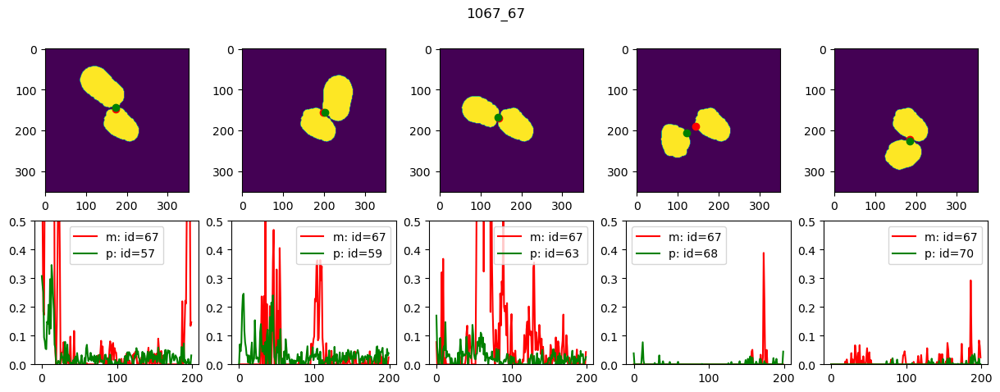

In [15]:
fig, ax = plt.subplots(2*len(m_list), len(p_list), figsize=(15, 5))
for i in range(0, len(m_list)):
    m = m_list[i]
    for j in range(0, len(p_list)):
        p = p_list[j]
        c_m = m_patch[m]
        c_p = p_patch[p]

        frames = list(set(c_m.frames).intersection(set(c_p.frames)))
        index_m = []
        index_p = []
        ax[i*2, j].imshow((c_m.tracking_mask[0]==m) | (c_m.tracking_mask[0]==p))
        flag = True
        for f in frames:
            coord_m = c_m.coordinates_[f]
            coord_p = c_p.coordinates_[f]
            dist, index1, index2 = find_nearnest_points(coord_m, coord_p)
            index_m.append(index1)
            index_p.append(index2)

            if flag:
                ax[i*2, j].scatter(coord_m[index_m[0], 1], coord_m[index_m[0], 0], c='r')
                ax[i*2, j].scatter(coord_p[index_p[0], 1], coord_p[index_p[0], 0], c='g')
                flag = False
        d_m = c_m.normlized_intensity[:,:,0]
        d_p = c_p.normlized_intensity[:,:,1]
        ax[i*2+1, j].plot(d_m[frames, index_m], label=f'm: id={m}',c='r')
        ax[i*2+1, j].plot(d_p[frames, index_p], label=f'p: id={p}', c='g')
        ax[i*2+1, j].legend()
        ax[i*2+1, j].set_ylim([0, 0.5])
fig.suptitle(f"{org_label}_{m}")
# plt.savefig(f"../figs/{org_label}_{m}.svg")

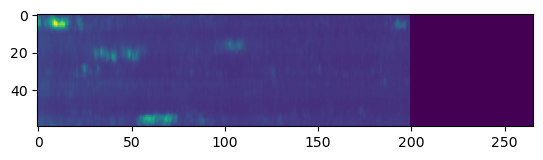

In [20]:
plt.imshow(c_m.patch_intensity[:,:,0].T)

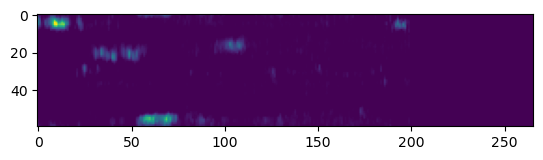

In [21]:
plt.imshow(c_m.normlized_intensity[:,:,0].T)

In [62]:
# patch = load_from_pkl(filename)
# patch.offsets = pd.DataFrame(np.zeros((len(patch.frames), 2)), index=patch.frames)

In [22]:
patch = c_m

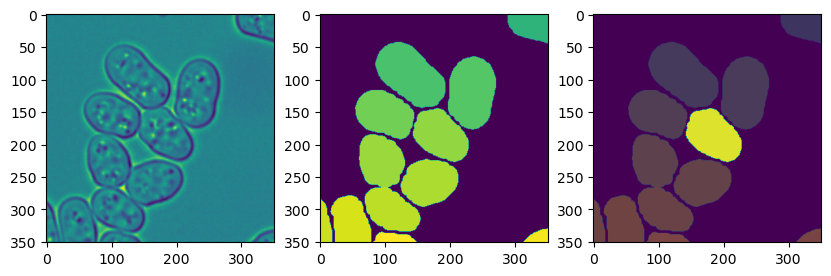

In [23]:
fig, axs = plt.subplots(1,3,figsize=(10, 5))
axs[0].imshow(patch.reference_image[0])
axs[1].imshow(patch.tracking_mask[0])
axs[2].imshow(patch.tracking_mask[0]==label)
axs[2].imshow(patch.tracking_mask[0], alpha=0.3)

In [24]:
intensity_data = patch.periphery_patch_intensity(percentile=80, channel=[0,1])

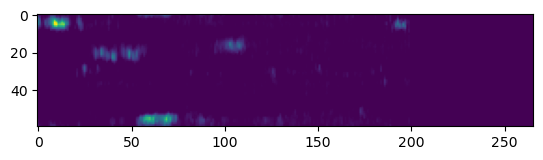

In [25]:
d = np.nan_to_num(patch.normlized_intensity[:,:,0], nan=0)
plt.imshow(d.T)

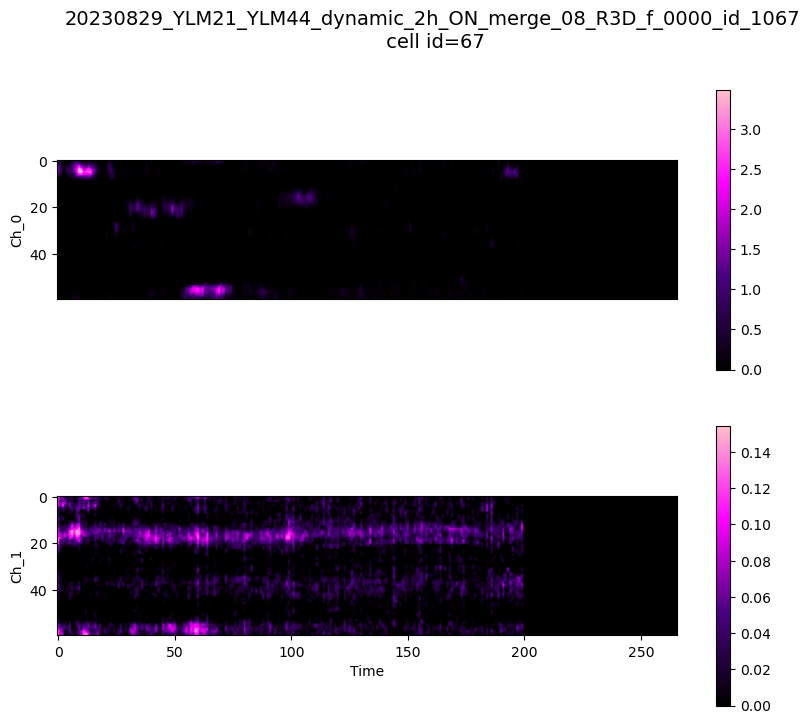

In [26]:
show_data = np.moveaxis(patch.normlized_intensity, -1, 0)
plot_patch_intensity(show_data, title=os.path.basename(filename)[:-4]+"\n cell id="+str(patch.id))

In [250]:
signal_patch = Singal(data=intensity_data[:,:,0],
                      angles=patch.angle_,
                      frames=patch.frames,
                      coordinates = np.array(list(patch.coordinates_)),
                      background=patch.background[:,0],
                      name=filename,)
_ = signal_patch.binary_mask_cal(threshold=0.3)
steps = signal_patch.transfer_steps()
time_steps = signal_patch.transfer_steps_keep_time()

In [254]:
signal_patch.center_angles()

array([2.10642432, 0.3991125 , 3.06475761, 5.98465432, 3.63748565,
       5.49286463])

In [255]:
signal_patch.center_angles()

array([2.10642432, 0.3991125 , 3.06475761, 5.98465432, 3.63748565,
       5.49286463])

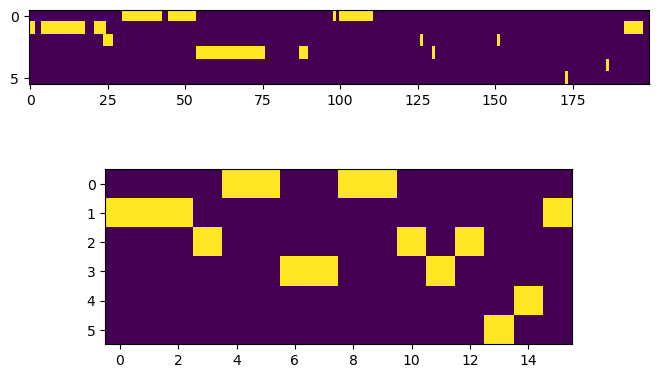

In [224]:
fig,ax = plt.subplots(2, 1, figsize=(8,5))
ax[0].imshow(time_steps[:200].T)
ax[0].set_aspect(4)
ax[1].imshow(steps.T)

In [248]:
cluster_centers = signal_patch.cluster.cluster_centers_
center_index = []
for i in range(0, cluster_centers.shape[0]):
    cluster_center = cluster_centers[i]
    dist, index1, index2 = find_nearnest_points([cluster_center], patch.coordinates_[0])
    center_index.append([index2, dist])
center_index = np.array(center_index)

In [249]:
center_index

array([[19.        ,  0.51928099],
       [ 4.        ,  1.45628546],
       [29.        ,  3.37403611],
       [56.        ,  3.00602865],
       [35.        ,  0.46747009],
       [50.        ,  2.11824413]])

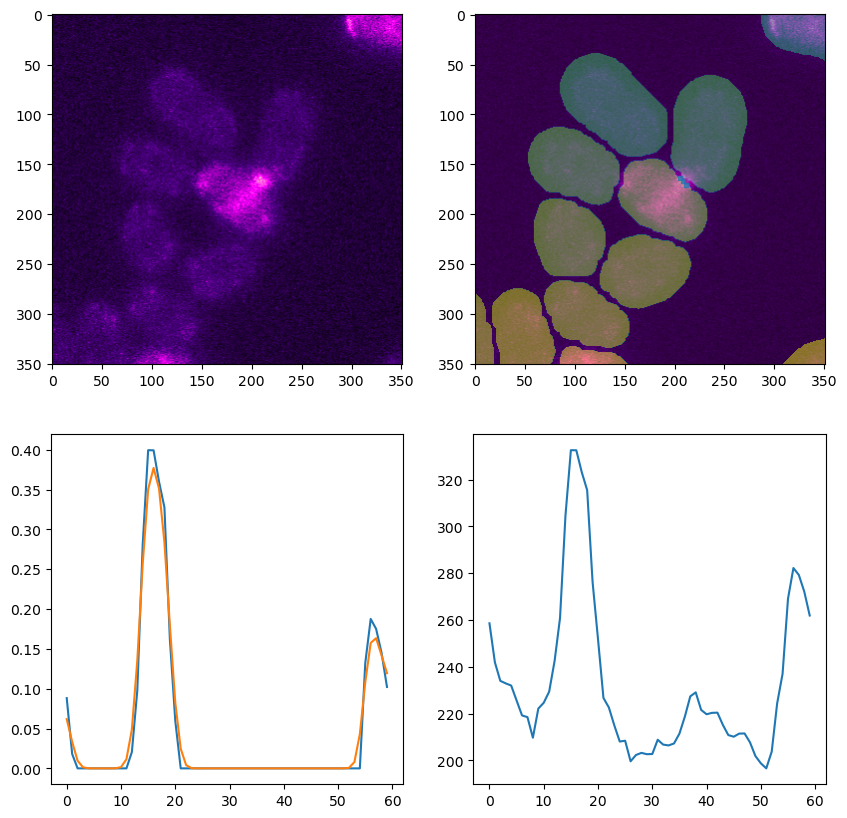

In [237]:
org_coord = patch.coordinates_
time = 100

coord_index = np.where(signal_patch._mask_org[time])[0]
coord_time = org_coord[time, coord_index]

fig,ax = plt.subplots(2, 2, figsize=(10,10))
ax[0, 0].imshow(patch.fluorescence_image[time, 0],cmap=COLOR_BlackPink)
ax[0, 1].imshow(patch.fluorescence_image[time, 0],cmap=COLOR_BlackPink)
ax[0, 1].imshow(patch.tracking_mask[time],alpha=0.5)
ax[0, 1].scatter(coord_time[:,1], coord_time[:,0],marker='s',alpha=0.7,s=10)
ax[1, 0].plot(patch.normlized_intensity[time,:,0])
ax[1, 0].plot(signal_patch.smooth[time], label="smoothed")
ax[1, 1].plot(patch.patch_intensity[time,:,0])
# fig.suptitle(f"threshold={signal_patch.threshold[time]}")
plt.show()

In [9]:
from cellmating.plot._playplot import PlayPlot
from cellmating.colormap import COLOR_BlackPink
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [10]:
c_p = p_patch[57]

NameError: name 'p_patch' is not defined

In [118]:
x = np.array([np.linspace(1,60,60,dtype=int) for i in range(0, 266)])
data ={
    "intensity_1":{
        "data": [x, patch.normlized_intensity[:,:,0]],
        "figure": "plot"
    },
    # "intensity_2":{
    #     "data": [x, intensity_data[:,:,1]],
    #     "figure": "plot"
    # },
    "fluorescent":{
        "data": patch.fluorescence_image[:,0,:,:],
        "figure": "imshow",
    },
    
    "fluorescent_p_57":{
        "data": patch.fluorescence_image[:,1,:,:],
        "figure": "imshow",
    },
    "refrence":{
        "data": patch.reference_image,
        "figure": "imshow",
    },
    "intensity_p_57":{
    "data": [x, p_patch[57].normlized_intensity[:,:,1]],
    "figure": "plot"
    },
    # "intensity_2":{
    #     "data": [x, intensity_data[:,:,1]],
    #     "figure": "plot"
    # },

    "intensity_p_59":{
    "data": [x, p_patch[59].normlized_intensity[:,:,1]],
    "figure": "plot"
    },
    # "intensity_2":{
    #     "data": [x, intensity_data[:,:,1]],
    #     "figure": "plot"
    # },
    "fluorescent_p_63":{
    "data": [x, p_patch[63].normlized_intensity[:,:,1]],
    "figure": "plot"
    },
    "fluorescent_p_70":{
    "data": [x, p_patch[70].normlized_intensity[:,:,1]],
    "figure": "plot"
    },
}

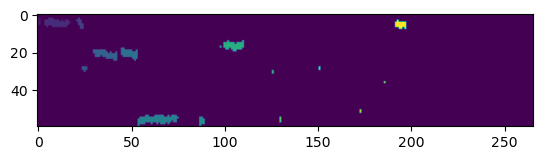

In [119]:
plt.imshow(signal_patch._mask_org.T)

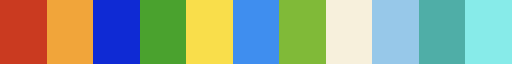

In [11]:
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
import math
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.font_manager
from scipy import stats

colors = [(202, 58, 32), (241, 165, 58), (15, 42, 212),(74, 162, 46),(249, 222, 75),(63, 142, 239),(128, 186, 56),(247, 240, 220),(151, 200, 233),(79, 174, 167),(135, 235, 233)]
colors_gaudi=[]
for a,b,c in colors:
    colors_gaudi.append((a/255,b/255,c/255))
colors_gaudi_16 = ['#f1a53', '#0f2ad4', '#4aa22e', '#f9de4b', '#3f8ef0',
                     '#80ba38', '#f7f0dc', '#97c8e9', '#4faea7', '#87ebe9']
COLOR_Gaudi = mpl.colors.ListedColormap(colors_gaudi)
COLOR_Gaudi

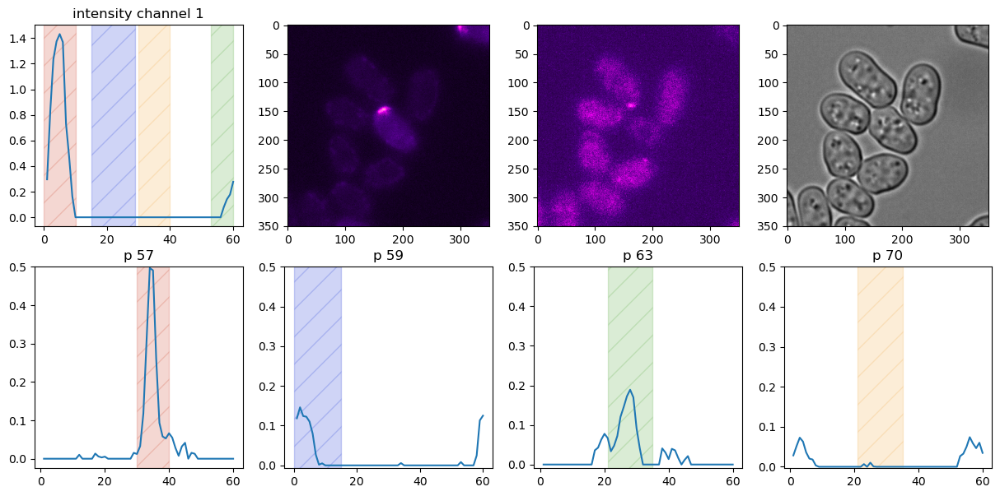

In [145]:
plot = PlayPlot(data=data, nrows=2, ncols=4, nframe=266, figsize=(15,7))
plot.lines[1].set_cmap(COLOR_BlackPink)
plot.lines[2].set_cmap(COLOR_BlackPink)
plot.lines[3].set_cmap("gray")
plot.axs[0].set_title("intensity channel 1")
# plot.axs[1].set_title("intensity channel 2")
plot.axs[4].set_title("p 57")
plot.axs[5].set_title("p 59")
plot.axs[6].set_title("p 63")
plot.axs[7].set_title("p 70")

plot.axs[4].set_ylim(top=0.5)
plot.axs[5].set_ylim(top=0.5)
plot.axs[6].set_ylim(top=0.5)
plot.axs[7].set_ylim(top=0.5)

# plot.axs[0].fill_between(10, 0, 1.5)
plot.axs[0].axvspan(0, 10, alpha=0.2, color=colors_gaudi[0], hatch="/")
plot.axs[0].axvspan(15, 29, alpha=0.2, color=colors_gaudi[2], hatch='/')
plot.axs[0].axvspan(30, 40, alpha=0.2, color=colors_gaudi[1], hatch="/")
plot.axs[0].axvspan(53, 60, alpha=0.2, color=colors_gaudi[3], hatch="/")

plot.axs[4].axvspan(30, 40, alpha=0.2, color=colors_gaudi[0], hatch="/")
plot.axs[5].axvspan(0, 15, alpha=0.2, color=colors_gaudi[2], hatch="/")
plot.axs[6].axvspan(21, 35, alpha=0.2, color=colors_gaudi[3], hatch="/")
plot.axs[7].axvspan(21, 35, alpha=0.2, color=colors_gaudi[1], hatch="/")
# plot.axs[0].plot([23, 23],[0, 1.5], "--")
# plot.axs[0].plot([35, 35],[0, 1.5], "--")
# plot.axs[0].plot([55, 55],[0, 1.5], "--")

In [144]:
anim.save('increasingStraightLine.mp4') 

In [142]:
anim = plot.play()
from IPython.display import HTML
HTML(anim.to_html5_video())

In [123]:
orginal = dv2rgb(img[:,:,:,0:3])
# segmentation = label2rgb(img[:,:,:,3])
show_img = np.concatenate((orginal, img[:,:,:,1:2], img[:,:,:,2:3]),axis=3)

NameError: name 'img' is not defined

Text(0.5, 1.0, 'SEGMENTATION')

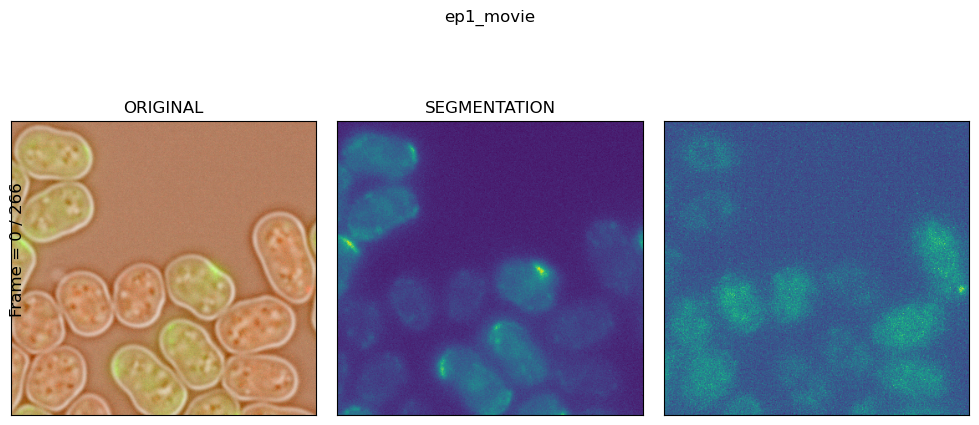

In [436]:
player = Play4DImage(show_img, ncols=3, figsize=(10,5),channel_map=[0,4,5,6])
anim = player.play()
# anim.save('./test.mp4', writer='ffmpeg', fps=10, dpi=100, metadata={'title':'test'})
player.fig.suptitle("ep1_movie")
player.fig.tight_layout(pad=1.5)
player.axs[0].set_title("ORIGINAL")
player.axs[1].set_title("SEGMENTATION")

In [437]:
from IPython.display import HTML
HTML(anim.to_html5_video())

### 1. patch 和邻居位置的关系
### 2. patch 停留时长和选择的关系
### 3. patch 转移概率和位置的关系

In [12]:
import sys
sys.path.append("../../")

import os
import numpy as np
from tqdm import trange
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

In [13]:
from cellmating.patch import Singal, ked_fit, DynamicPatch, patch_neighbor_distance_feature
from cellmating.io import imread, imsave
from cellmating.utils import file_traverse
from cellmating.cells import create_cells_from_image_for_patch
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [14]:
file_list = file_traverse("/media/wd/T7/data/dynamic/20230828/selected/", file_regular=r".*/[1-9]/.*.tif$")

In [102]:
all_data_index_time_point = pd.DataFrame()
for i in trange(0, len(file_list)):
    try:
        filename = file_list[i]
        channle = int(filename.split("/")[-2])-1
        
        org_label = int(filename.split("_")[-1][:-4])
        label = org_label%1000
        image = imread(filename)
        # image = np.moveaxis(image, -1, 1)
        # cells = create_tracker_from_image(image[:,-1])
        
        cells = create_cells_from_image_for_patch((image[:,-1]==org_label)*org_label)
        c = cells[label]
        c.tracking_mask = image[:,-1]%1000
        c.reference_image = image[:,0]
        c.fluorescence_image = image[:,1:-2]
        patch = DynamicPatch.from_cell(c)
        dump_to_pkl(patch, filename[:-4]+".pkl")
         # patch = load_from_pkl(filename[:-4]+".pkl")
        intensity_data = patch.periphery_patch_intensity(percentile=80, channel=[0,1])
       

        # time_point = [0, 50, 100, 150, 200, 266]
        time_point = [[0,266], [0,50], [50,100], [100,150], [150, 200], [200, 266]]
        try:
            for t in range(0, len(time_point)):
                s, e = time_point[t]
                signal_patch = Singal(data=intensity_data[s:e,:,channle],
                      angles=patch.angle_[s:e],
                      frames=patch.frames[s:e],
                      coordinates = np.array(list(patch.coordinates_))[s:e],
                      background=patch.background[s:e,channle],
                      name=filename,)

                a = signal_patch.labeled_binary()
                if a is not None:
                    steps = signal_patch.transfer_steps()

                    patch_data = signal_patch._patch_features
                    if patch_data.shape[0]<2:
                        continue
                    x, y_patch = ked_fit(patch_data[:, 4]/60, bw_adjust=0.25)

                    distance_data = patch.neighbor_distance_angle_index
                    x, y_dist = ked_fit(distance_data[0]/60, bw_method=0.1, weights=distance_data[1].max() - distance_data[1])

                    feature = patch_neighbor_distance_feature(x ,y_patch, y_dist)

                    feature = list(feature)
                    data = pd.DataFrame(feature, 
                                        columns=["Deviation", "patch_angle", "patch_time",
                                                 "neighbor_angle", "neighbor_distance","top_patch","top_neiber"])
                    data['timepoint'] = t
                    data['filename'] = filename
                    all_data_index_time_point = pd.concat([all_data_index_time_point, data])
        except Exception as error:
                # handle the exception
            print(t, filename, error)
    except Exception as error:
        # handle the exception
        print(i, filename, error)

  1%|▋                                                                                                          | 2/310 [00:29<1:16:19, 14.87s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
  2%|█▋                                                                                                         | 5/310 [01:26<1:39:46, 19.63s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1030.tif singular matrix


  2%|██▍                                                                                                        | 7/310 [02:32<2:16:58, 27.12s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
  3%|███▍                                                                                                      | 10/310 [03:18<1:33:13, 18.65s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1048.tif singular matrix


/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
  4%|████▍                                                                                                     | 13/310 [04:07<1:19:40, 16.10s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1057.tif singular matrix


  5%|████▊                                                                                                     | 14/310 [04:16<1:08:20, 13.85s/it]

5 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1007.tif singular matrix


  6%|██████▏                                                                                                   | 18/310 [05:11<1:09:53, 14.36s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1019.tif singular matrix


  8%|████████▏                                                                                                 | 24/310 [06:58<1:28:13, 18.51s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1044.tif singular matrix


/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
  8%|████████▉                                                                                                 | 26/310 [07:27<1:18:50, 16.66s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1071.tif singular matrix


  9%|█████████▉                                                                                                | 29/310 [08:18<1:17:28, 16.54s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1081.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 10%|██████████▌                                                                                               | 31/310 [08:59<1:23:50, 18.03s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_03_R3D_f_0000_id_1007.tif singular matrix


 11%|███████████▎                                                                                              | 33/310 [10:05<1:49:37, 23.75s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_03_R3D_f_0000_id_1011.tif singular matrix


 13%|█████████████▎                                                                                            | 39/310 [11:35<1:10:16, 15.56s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_03_R3D_f_0000_id_1032.tif singular matrix


 13%|█████████████▋                                                                                            | 40/310 [12:05<1:29:31, 19.90s/it]/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
 14%|███████████████▎                                                                                            | 44/310 [12:31<43:30,  9.81s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_04_R3D_f_0000_id_1011.tif index 144 is out of bounds for axis 0 with size 140


/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 15%|████████████████▋                                                                                           | 48/310 [13:12<47:19, 10.84s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_05_R3D_f_0000_id_1005.tif singular matrix


 17%|█████████████████▊                                                                                        | 52/310 [14:31<1:16:31, 17.79s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_05_R3D_f_0000_id_1017.tif singular matrix


 18%|███████████████████▍                                                                                      | 57/310 [16:07<1:05:29, 15.53s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 19%|████████████████████▉                                                                                       | 60/310 [16:39<52:51, 12.69s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 21%|██████████████████████▎                                                                                     | 64/310 [17:15<38:26,  9.38s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_06_R3D_f_0000_id_1045.tif singular matrix


 21%|██████████████████████▉                                                                                     | 66/310 [17:40<43:46, 10.76s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 23%|████████████████████████▍                                                                                   | 70/310 [18:24<45:10, 11.29s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_06_R3D_f_0000_id_1062.tif singular matrix


 24%|█████████████████████████▍                                                                                  | 73/310 [18:52<37:16,  9.44s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_06_R3D_f_0000_id_1066.tif index 228 is out of bounds for axis 0 with size 227


 24%|██████████████████████████▏                                                                                 | 75/310 [19:23<51:06, 13.05s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 25%|██████████████████████████▎                                                                               | 77/310 [19:58<1:01:17, 15.78s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 27%|█████████████████████████████▌                                                                              | 85/310 [21:48<46:48, 12.48s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 28%|████████████████████

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_06_R3D_f_0000_id_1106.tif singular matrix


/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 29%|███████████████████████████████                                                                             | 89/310 [22:24<36:28,  9.90s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 30%|███████████████████████████████▍                                                                          | 92/310 [23:51<1:15:24, 20.75s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 30%|████████████████████████████████▏                                                                         | 94/310 [24:20<1:01:02, 16.96s/it]

4 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1030.tif singular matrix


 31%|█████████████████████████████████▏                                                                        | 97/310 [25:34<1:13:56, 20.83s/it]

5 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1041.tif singular matrix


 32%|█████████████████████████████████▌                                                                        | 98/310 [25:57<1:15:37, 21.40s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1045.tif singular matrix


 32%|█████████████████████████████████▊                                                                        | 99/310 [26:17<1:13:16, 20.84s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1046.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 32%|█████████████████████████████████▊                                                                       | 100/310 [26:48<1:23:38, 23.90s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1047.tif singular matrix


 33%|██████████████████████████████████▉                                                                      | 103/310 [27:47<1:10:04, 20.31s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1063.tif singular matrix


 36%|██████████████████████████████████████▎                                                                    | 111/310 [29:41<52:12, 15.74s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_08_R3D_f_0000_id_1028.tif singular matrix


 36%|██████████████████████████████████████▎                                                                  | 113/310 [30:29<1:06:12, 20.16s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_08_R3D_f_0000_id_1045.tif singular matrix


 38%|████████████████████████████████████████▍                                                                  | 117/310 [31:45<57:26, 17.86s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 38%|████████████████████████████████████████▋                                                                  | 118/310 [32:02<56:09, 17.55s/it]

5 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_08_R3D_f_0000_id_1058.tif singular matrix


 39%|████████████████████████████████████████▉                                                                | 121/310 [33:04<1:01:12, 19.43s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 40%|██████████████████████████████████████████▍                                                                | 123/310 [33:22<43:39, 14.01s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 40%|██████████████████████████████████████████▊                                                                | 124/310 [33:34<40:40, 13.12s/it]

5 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1005.tif singular matrix


 41%|███████████████████████████████████████████▍                                                               | 126/310 [34:02<41:39, 13.59s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 41%|████████████████████████████████████████████▏                                                              | 128/310 [34:27<39:33, 13.04s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 42%|████████████████████████████████████████████▊                                                              | 130/310 [34:45<32:20, 10.78s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1019.tif singular matrix


 43%|█████████████████████████████████████████████▌                                                             | 132/310 [35:04<29:18,  9.88s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1025.tif singular matrix


 43%|█████████████████████████████████████████████▉                                                             | 133/310 [35:12<27:28,  9.31s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 44%|███████████████████████████████████████████████▎                                                           | 137/310 [35:54<28:05,  9.74s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1041.tif singular matrix


 45%|████████████████████████████████████████████████▋                                                          | 141/310 [36:34<28:52, 10.25s/it]

5 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1053.tif singular matrix


/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 46%|█████████████████████████████████████████████████▎                                                         | 143/310 [36:56<29:25, 10.57s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1058.tif singular matrix


 47%|██████████████████████████████████████████████████▋                                                        | 147/310 [38:04<48:56, 18.01s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 48%|███████████████████████████████████████████████████                                                        | 148/310 [38:30<54:52, 20.32s/it]

1 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_10_R3D_f_0000_id_1009.tif singular matrix


 48%|███████████████████████████████████████████████████▍                                                       | 149/310 [38:38<44:30, 16.59s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_10_R3D_f_0000_id_1013.tif singular matrix


 48%|███████████████████████████████████████████████████▊                                                       | 150/310 [39:00<48:54, 18.34s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_10_R3D_f_0000_id_1015.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 49%|████████████████████████████████████████████████████▍                                                      | 152/310 [39:36<47:22, 17.99s/it]

3 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_10_R3D_f_0000_id_1024.tif singular matrix


 49%|████████████████████████████████████████████████████▊                                                      | 153/310 [40:05<55:38, 21.27s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 52%|███████████████████████████████████████████████████████▉                                                   | 162/310 [43:59<57:37, 23.36s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 54%|█████████████████████████████████████████████████████████▋                                                 | 167/310 [45:07<37:13, 15.62s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1029.tif singular matrix


 54%|█████████████████████████████████████████████████████████▉                                                 | 168/310 [45:14<31:00, 13.10s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1034.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 57%|████████████████████████████████████████████████████████████▋                                              | 176/310 [46:48<20:30,  9.18s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1009.tif singular matrix


 57%|█████████████████████████████████████████████████████████████                                              | 177/310 [46:59<21:19,  9.62s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1011.tif singular matrix


 58%|██████████████████████████████████████████████████████████████▍                                            | 181/310 [47:58<32:03, 14.91s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1026.tif singular matrix


 59%|███████████████████████████████████████████████████████████████▏                                           | 183/310 [48:46<39:26, 18.63s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_02_R3D_f_0000_id_1031.tif singular matrix


 63%|███████████████████████████████████████████████████████████████████▋                                       | 196/310 [52:44<32:35, 17.15s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_03_R3D_f_0000_id_1018.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 64%|████████████████████████████████████████████████████████████████████▎                                      | 198/310 [53:14<28:30, 15.27s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_03_R3D_f_0000_id_1021.tif singular matrix


 64%|████████████████████████████████████████████████████████████████████▋                                      | 199/310 [53:22<23:59, 12.96s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_03_R3D_f_0000_id_1029.tif singular matrix


 65%|█████████████████████████████████████████████████████████████████████▋                                     | 202/310 [53:45<16:46,  9.32s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_04_R3D_f_0000_id_1005.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 66%|██████████████████████████████████████████████████████████████████████▊                                    | 205/310 [54:10<15:16,  8.73s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_04_R3D_f_0000_id_1010.tif singular matrix


 67%|███████████████████████████████████████████████████████████████████████▊                                   | 208/310 [54:34<13:52,  8.17s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_04_R3D_f_0000_id_1017.tif singular matrix


 68%|█████████████████████████████████████████████████████████████████████████▏                                 | 212/310 [55:23<22:07, 13.55s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_05_R3D_f_0000_id_1010.tif singular matrix


 70%|██████████████████████████████████████████████████████████████████████████▉                                | 217/310 [56:40<19:06, 12.33s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_06_R3D_f_0000_id_1004.tif singular matrix


 74%|██████████████████████████████████████████████████████████████████████████████▋                            | 228/310 [58:20<12:09,  8.89s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 75%|████████████████████████████████████████████████████████████████████████████████                           | 232/310 [58:52<10:38,  8.19s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 75%|████████████████████████████████████████████████████████████████████████████████▍                          | 233/310 [59:03<11:21,  8.85s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_06_R3D_f_0000_id_1056.tif singular matrix


 80%|████████████████████████████████████████████████████████████████████████████████████                     | 248/310 [1:02:45<19:54, 19.26s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1017.tif singular matrix


 84%|███████████████████████████████████████████████████████████████████████████████████████▋                 | 259/310 [1:06:03<12:07, 14.26s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1067.tif singular matrix


 84%|████████████████████████████████████████████████████████████████████████████████████████                 | 260/310 [1:06:09<09:50, 11.82s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_07_R3D_f_0000_id_1069.tif singular matrix


 87%|███████████████████████████████████████████████████████████████████████████████████████████              | 269/310 [1:08:34<11:53, 17.41s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_08_R3D_f_0000_id_1042.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 87%|███████████████████████████████████████████████████████████████████████████████████████████▊             | 271/310 [1:09:02<09:47, 15.07s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_08_R3D_f_0000_id_1049.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████▏       | 287/310 [1:12:59<03:29,  9.09s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1031.tif singular matrix


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████▌       | 288/310 [1:13:09<03:25,  9.32s/it]/home/wd/project/cellmating/run/../../cellmating/patch/dynamic_patch.py:172: RuntimeWarning: invalid value encountered in divide
  (data - data.min()) / (data.max() - data.min())
 95%|███████████████████████████████████████████████████████████████████████████████████████████████████▏     | 293/310 [1:13:45<02:01,  7.13s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1056.tif singular matrix


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████▉     | 295/310 [1:14:00<01:47,  7.13s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_09_R3D_f_0000_id_1064.tif singular matrix


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 300/310 [1:15:23<02:11, 13.19s/it]

2 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_10_R3D_f_0000_id_1011.tif Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by NearestNeighbors.


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 302/310 [1:16:05<02:20, 17.61s/it]

0 /media/wd/T7/data/dynamic/20230828/selected/2/20230829_YLM21_YLM44_dynamic_2h_ON_merge_10_R3D_f_0000_id_1014.tif singular matrix


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 310/310 [1:18:43<00:00, 15.24s/it]


In [104]:
all_data_index_time_point.to_csv("./csv/dynamic_patch_neiber_distance_index_all_time_point.csv")

In [323]:
file_list = file_traverse("/media/wd/T7/data/dynamic/20230828/selected/", file_regular=r".*/[1-9]/.*.pkl$")

In [324]:
all_dict_pre_182 = {}
for i in trange(0, len(file_list)):
    try:
        filename = file_list[i]
        channle = int(filename.split("/")[-2])-1
        patch = load_from_pkl(filename)
        intensity_data = patch.periphery_patch_intensity(percentile=80, channel=[0,1])

        signal_patch = Singal(data=intensity_data[:182,:,channle],
          angles=patch.angle_[:182],
          frames=patch.frames[:182],
          coordinates = np.array(list(patch.coordinates_))[:182],
          background=patch.background[:182,channle],
          name=filename,)
        a = signal_patch.labeled_binary()
        if a is not None:

            steps = signal_patch.transfer_steps()
            steps_time = signal_patch.transfer_steps_keep_time()
            angles = signal_patch.center_angles()*180/np.pi
            trans_dict = signal_patch.transfer_heat_map()
            all_dict_pre_182[filename] = trans_dict
    except Exception as error:
        # handle the exception
        print(i, filename, error)

 13%|█████████████████████▍                                                                                                                                                | 40/310 [05:42<38:45,  8.61s/it]/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
 14%|███████████████████████▌                                                                                                                                              | 44/310 [05:56<21:45,  4.91s/it]

43 /media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_04_R3D_f_0000_id_1011.pkl index 144 is out of bounds for axis 0 with size 140


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 310/310 [42:36<00:00,  8.25s/it]


In [325]:
dump_to_pkl(all_dict_pre_182, "./csv/patch_heatmap_dict_time_pre182.pkl")

In [328]:
dump_to_pkl(all_dict, "./csv/patch_heatmap_dict.pkl")

In [331]:
keys = list(all_dict_pre_182.keys())

,False,False,False,False,False
113,0.0,0.0,0.0,0.0,0.0
119,0.0,0.0,1.0,0.0,0.0
119,1.0,0.0,0.0,0.0,0.0
125,0.0,1.0,0.0,0.0,0.0
133,0.0,0.0,0.0,1.0,0.0


/tmp/ipykernel_58363/4156860203.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax = plt.subplots()


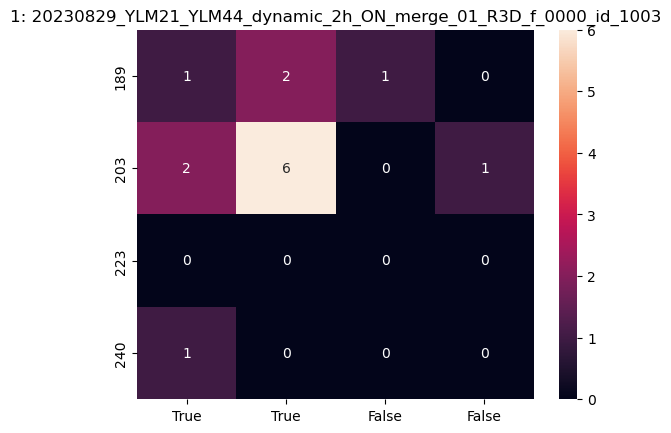

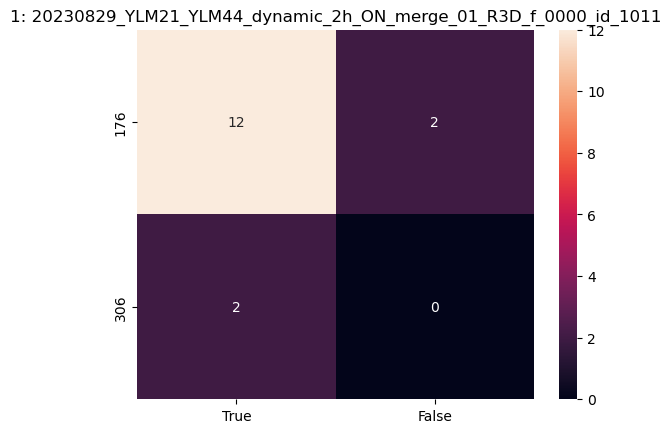

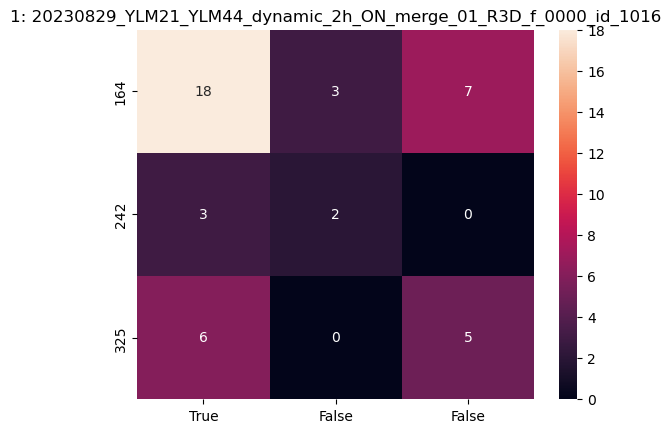

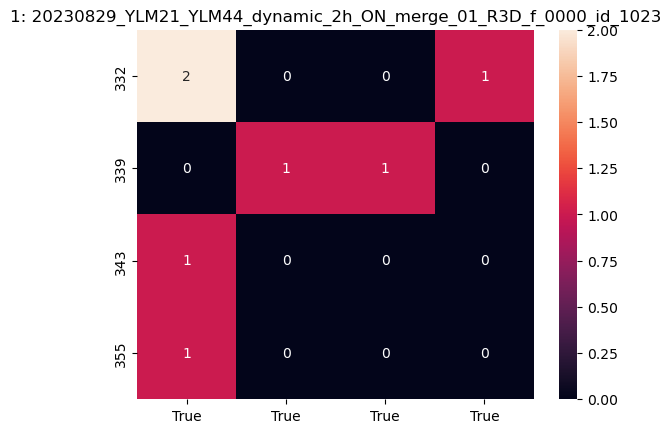

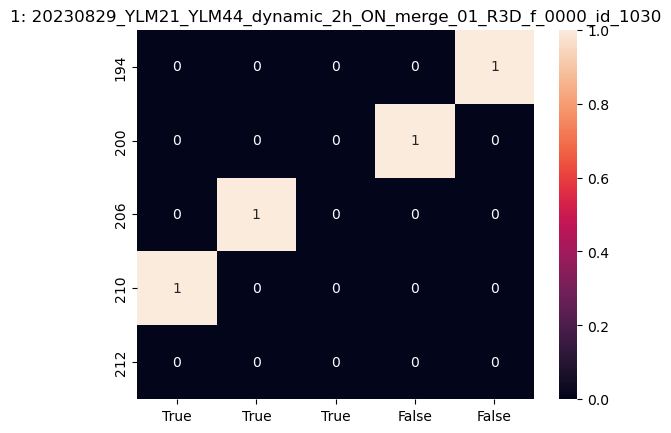

...

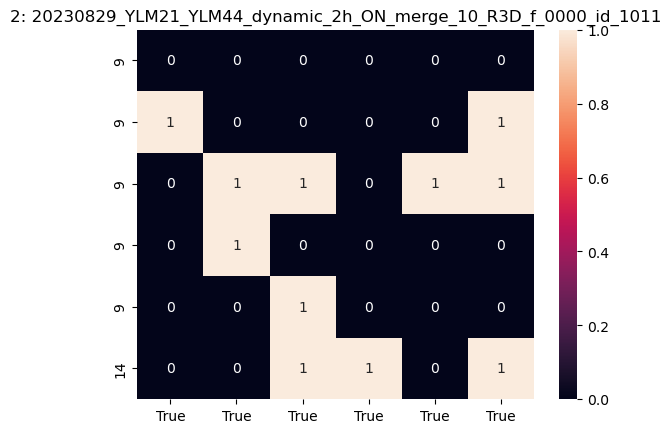

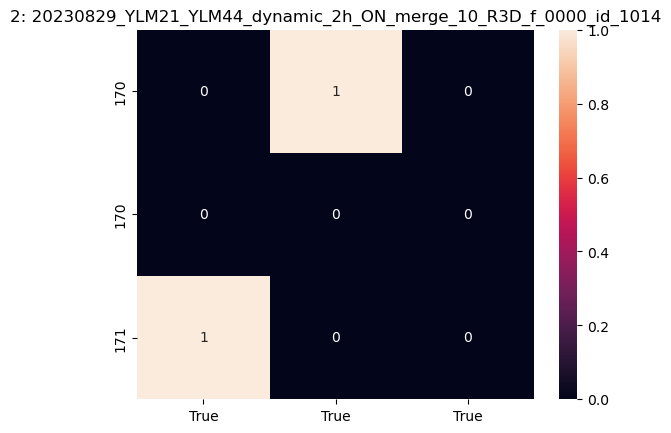

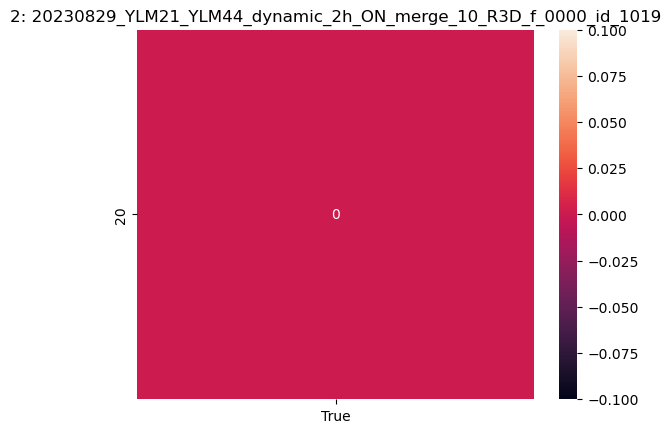

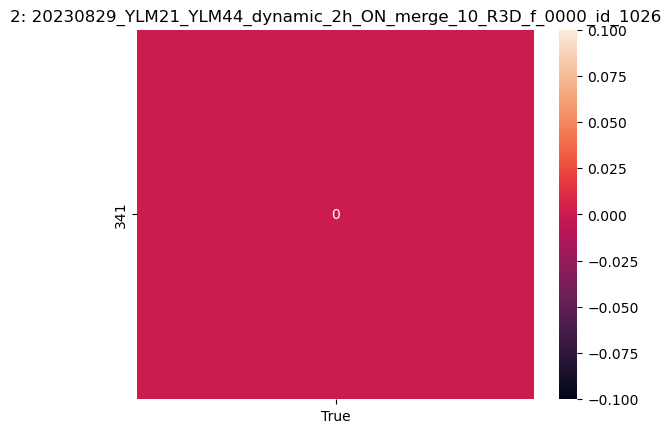

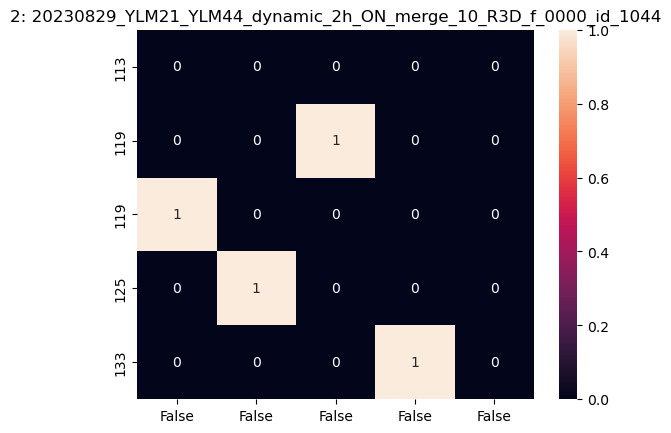

In [339]:
for k in keys:
    data = pd.DataFrame(all_dict_pre_182[k]['map'], index=all_dict_pre_182[k]['angle'].astype(np.int_),columns=all_dict_pre_182[k]['tips'])
    index = np.argsort(all_dict_pre_182[k]['angle'])
    data = data.iloc[index, index]
    fig,ax = plt.subplots()
    ax = sns.heatmap(data, annot=True,)
    ty = k.split("/")[-2]
    name = os.path.basename(k)[:-4]
    ax.set_title(f"{ty}: {name}")

<Axes: >

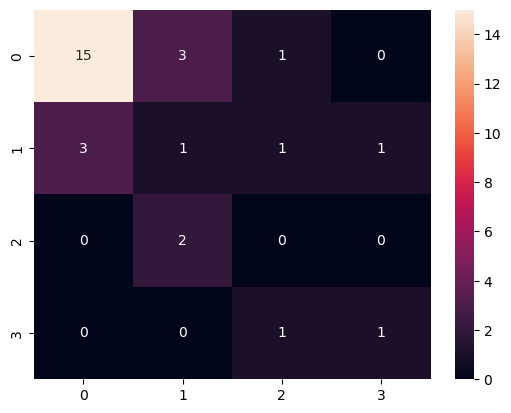

In [340]:
filename = "/media/wd/T7/data/dynamic/20230828/selected/1/20230829_YLM21_YLM44_dynamic_2h_ON_merge_06_R3D_f_0000_id_1105.pkl"
channle = int(filename.split("/")[-2])-1
        
org_label = int(filename.split("_")[-1][:-4])
label = org_label%1000
patch = load_from_pkl(filename[:-4]+".pkl")

intensity_data = patch.periphery_patch_intensity(percentile=80, channel=[0,1])

In [341]:
signal_patch = Singal(data=intensity_data[:,:,channle],
  angles=patch.angle_[:],
  frames=patch.frames[:],
  coordinates = np.array(list(patch.coordinates_))[:],
  background=patch.background[:,channle],
  name=filename,)

steps = signal_patch.transfer_steps()
time_steps = signal_patch.transfer_steps_keep_time()
angles = signal_patch.center_angles()*180/np.pi
trans_dict = signal_patch.transfer_heat_map()

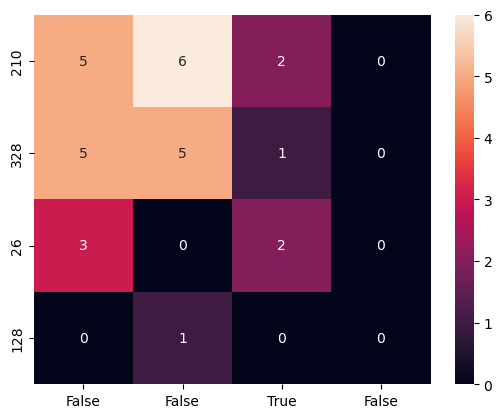

In [342]:
data = pd.DataFrame(trans_dict['map'], index=trans_dict['angle'].astype(np.int_),columns=trans_dict['tips'])
ax = sns.heatmap(data, annot=True,)

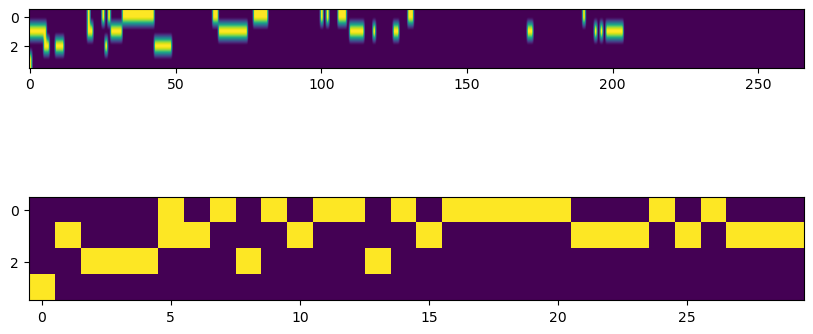

In [343]:
fig,ax = plt.subplots(2, 1, figsize=(10,5))
ax[0].imshow(time_steps.T)
ax[0].set_aspect(5)
ax[1].imshow(steps.T) 

In [344]:
x = np.array([np.linspace(1,60,60,dtype=int) for i in range(0, 266)])
data ={
    "intensity_1":{
        "data": [x, patch.normlized_intensity[:,:,0]],
        "figure": "plot"
    },
    "fluorescent":{
        "data": patch.fluorescence_image[:,0,:,:],
        "figure": "imshow",
    }
}

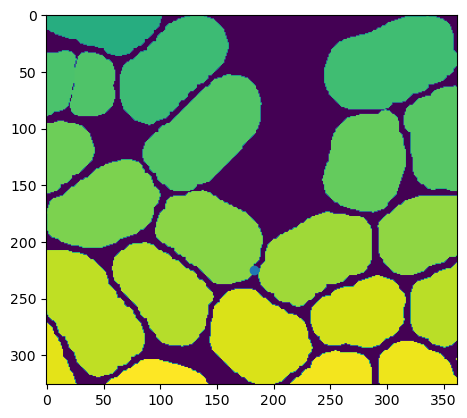

In [345]:
plt.imshow(patch.tracking_mask[0])
plt.scatter(patch.coordinates_[0, 30, 1], patch.coordinates_[0, 30, 0])

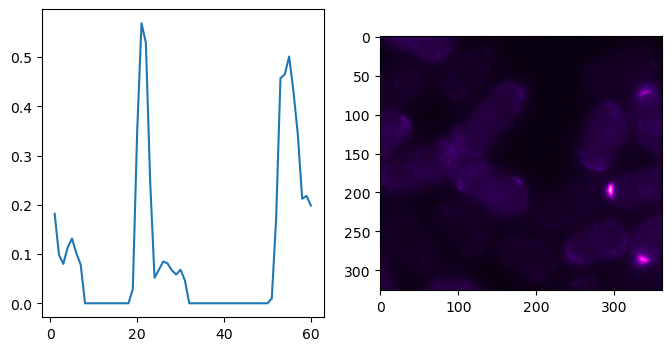

In [346]:
plot = PlayPlot(data=data, nrows=1, ncols=2, nframe=266, figsize=(8,4))
plot.lines[1].set_cmap(COLOR_BlackPink)

In [347]:
anim = plot.play()
from IPython.display import HTML
HTML(anim.to_html5_video())

In [17]:
filename = file_list[0]

org_label = int(filename.split("_")[-1][:-4])
label = org_label%1000
image = imread(filename)
# image = np.moveaxis(image, -1, 1)
# cells = create_tracker_from_image(image[:,-1])
cells = create_cells_from_image_for_patch((image[:,-1]==org_label)*org_label)
c = cells[label]

c.tracking_mask = image[:,-1]%1000
c.reference_image = image[:,0]
c.fluorescence_image = image[:,1:-2]
patch = DynamicPatch.from_cell(c)
dump_to_pkl(patch, filename[:-4]+".pkl")

# patch = load_from_pkl(filename[:-4]+".pkl")

intensity = patch.periphery_patch_intensity(percentile=90, channel=[0, 1])
# time_point = [0, 50, 100, 150, 200, 266]
time_point = [[0,266], [0,50], [50,100], [100,150], [150, 200], [200, 266]]

for t in range(0, len(time_point)):
    s, e = time_point[t]
    signal_patch = Singal(data = patch.patch_intensity[s:e,:,0],
                              angles = patch.angle_[s:e],
                              frames = patch.frames[s:e],
                              coordinates = patch.coordinates_[s:e],
                              background = patch.background[s:e,0],
                              name = filename)
    steps = signal_patch.transfer_steps()
    patch_data = signal_patch._patch_features
    if patch_data.shape[0]<2:
        continue
    x, y_patch = ked_fit(patch_data[:, 4]/60, bw_adjust=0.25)

    distance_data = patch.neighbor_distance_angle_index
    x, y_dist = ked_fit(distance_data[0]/60, bw_method=0.1, weights=distance_data[1].max() - distance_data[1])

    feature = patch_neighbor_distance_feature(x ,y_patch, y_dist)

    feature = list(feature)
    data = pd.DataFrame(feature, 
                        columns=["Deviation", "patch_angle", "patch_time",
                                 "neighbor_angle", "neighbor_distance","top_patch","top_neiber"])
    data['timepoint'] = t
    data['filename'] = filename

/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [18]:
data

,Deviation,patch_angle,patch_time,neighbor_angle,neighbor_distance,top_patch,top_neiber,timepoint,filename
0,5.0,0.322034,0.458840,0.237288,2.009912,19.0,14.0,5,/media/wd/T7/data/dynamic/20230828/crop/202308...
1,7.0,0.491525,3.884386,0.610169,0.103857,29.0,36.0,5,/media/wd/T7/data/dynamic/20230828/crop/202308...
2,1.0,0.932203,5.703227,0.915254,1.950279,55.0,54.0,5,/media/wd/T7/data/dynamic/20230828/crop/202308...


In [15]:
image = imread("/media/wd/T7/data/dynamic/20230828/merge/20230829_YLM21_YLM44_dynamic_2h_ON_merge_06_R3D.tif")[:,:3]

In [30]:
new_image = np.zeros((266, 1024, 1024, 4), dtype=np.uint8)
for i in range(0, image.shape[0]):
    normd = (image[i] / image[i].max(axis=(1,2))[:, None, None] * 255).astype(np.uint8)
    new_image[i,:,:,0] = normd[2].clip(50)
    new_image[i,:,:,1] = normd[1].clip(30)
    new_image[i,:,:,3] = normd[0]

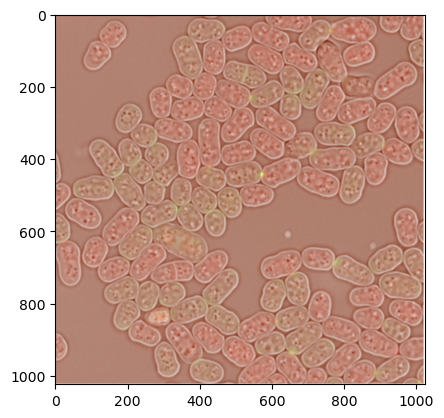

In [33]:
plt.imshow(new_image[6])

In [479]:
filename=file_list[0]
patch = load_from_pkl(filename[:-4]+".pkl")
intensity = patch.periphery_patch_intensity(percentile=90, channel=[0, 1])

/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/wd/miniconda3/envs/deepyeast/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [520]:
time_point = [0, 50, 100, 150, 200, 266]
for t in range(1, len(time_point)):
    
    s = time_point[t-1]
    e = time_point[t]
    print(s)
    signal_patch = Singal(data = patch.patch_intensity[s:e,:,0],
                              angles = patch.angle_[s:e],
                              frames = patch.frames[s:e],
                              coordinates = patch.coordinates_[s:e],
                              background = patch.background[s:e,0],
                              name = filename)

    steps = signal_patch.transfer_steps()
    patch_data = signal_patch._patch_features
    if patch_data.shape[0]<2:
                    continue
    x, y_patch = ked_fit(patch_data[:, 4]/60, bw_adjust=0.25)

    distance_data = patch.neighbor_distance_angle_index
    x, y_dist = ked_fit(distance_data[0]/60, bw_method=0.1, weights=distance_data[1].max() - distance_data[1])

    feature = patch_neighbor_distance_feature(x ,y_patch, y_dist)

    feature = list(feature)
    data = pd.DataFrame(feature, 
                        columns=["Deviation", "patch_angle", "patch_time",
                                 "neighbor_angle", "neighbor_distance","top_patch","top_neiber"])
    data['timepoint'] = s
    data['filename'] = filename
    all_data_index_time_point = pd.concat([all_data_index_time_point, data])

0
50
100
150
200


In [521]:
all_data_index_time_point

,Deviation,patch_angle,patch_time,neighbor_angle,neighbor_distance,top_patch,top_neiber,timepoint,filename
0,6.0,0.508475,3.348860,0.610169,0.103857,30.0,36.0,50,/media/wd/T7/data/dynamic/20230828/crop/202308...
1,1.0,0.898305,3.379911,0.915254,1.950279,53.0,54.0,50,/media/wd/T7/data/dynamic/20230828/crop/202308...
0,0.0,0.915254,66.828675,0.915254,1.950279,54.0,54.0,100,/media/wd/T7/data/dynamic/20230828/crop/202308...
0,9.0,0.457627,3.701395,0.610169,0.103857,27.0,36.0,150,/media/wd/T7/data/dynamic/20230828/crop/202308...
1,0.0,0.915254,5.144425,0.915254,1.950279,54.0,54.0,150,/media/wd/T7/data/dynamic/20230828/crop/202308...
0,5.0,0.322034,0.458840,0.237288,2.009912,19.0,14.0,200,/media/wd/T7/data/dynamic/20230828/crop/202308...
1,7.0,0.491525,3.884386,0.610169,0.103857,29.0,36.0,200,/media/wd/T7/data/dynamic/20230828/crop/202308...
2,1.0,0.932203,5.703227,0.915254,1.950279,55.0,54.0,200,/media/wd/T7/data/dynamic/20230828/crop/202308...


In [510]:
patch_data

array([[  0.        ,  24.        ,  49.        ,  45.        ,
         54.        ,   3.        ,   4.82700061,   5.75285057,
          0.28929993,  41.90221098, 154.40221098],
       [  0.        ,  24.        ,  49.        ,  45.        ,
         54.        ,   3.        ,   4.82700061,   5.75285057,
          0.28929993,  41.90221098, 154.40221098]])

In [496]:
all_data_index_time_point

,Deviation,patch_angle,patch_time,neighbor_angle,neighbor_distance,top_patch,top_neiber,timepoint,filename
0,6.0,0.508475,3.348860,0.610169,0.103857,30.0,36.0,0,/media/wd/T7/data/dynamic/20230828/crop/202308...
1,1.0,0.898305,3.379911,0.915254,1.950279,53.0,54.0,0,/media/wd/T7/data/dynamic/20230828/crop/202308...
0,9.0,0.457627,3.500587,0.610169,0.103857,27.0,36.0,100,/media/wd/T7/data/dynamic/20230828/crop/202308...
1,0.0,0.915254,5.686763,0.915254,1.950279,54.0,54.0,100,/media/wd/T7/data/dynamic/20230828/crop/202308...
0,5.0,0.322034,0.458840,0.237288,2.009912,19.0,14.0,200,/media/wd/T7/data/dynamic/20230828/crop/202308...
1,7.0,0.491525,3.884386,0.610169,0.103857,29.0,36.0,200,/media/wd/T7/data/dynamic/20230828/crop/202308...
2,1.0,0.932203,5.703227,0.915254,1.950279,55.0,54.0,200,/media/wd/T7/data/dynamic/20230828/crop/202308...


In [494]:
patch_data.shape

(1, 11)

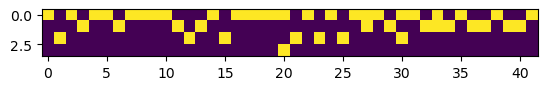

In [436]:
plt.imshow(steps.T)

In [461]:
signal_patch = Singal(data = patch.patch_intensity[200:250,:,0],
                          angles = patch.angle_[200:250],
                          frames = patch.frames[200:250],
                          coordinates = patch.coordinates_[200:250],
                          background = patch.background[200:250,0],
                          name = filename)

In [462]:
steps = signal_patch.transfer_steps()
patch_data = signal_patch._patch_features

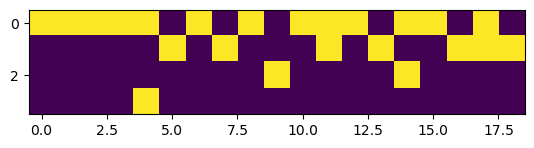

In [463]:
plt.imshow(steps.T)

In [393]:
data = pd.DataFrame(all_data_index, columns=["Deviation", "patch_angle", "patch_time", "neighbor_angle", "neighbor_distance","top_patch","top_neiber"])

In [394]:
data.to_csv("./csv/dynamic_patch_neiber_distance_index.csv")

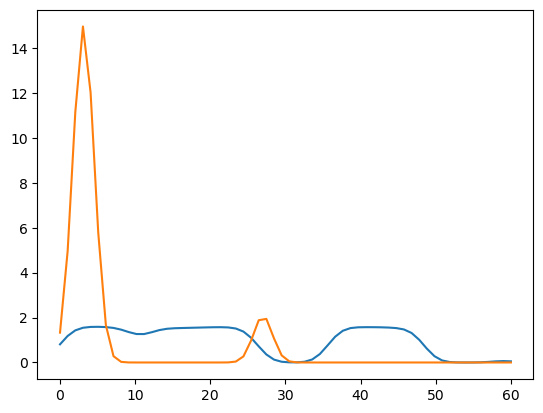

In [395]:
plt.plot(x*60, y_dist)
plt.plot(x*60, y_patch)

In [355]:
from scipy.signal import argrelextrema
from sklearn.neighbors import NearestNeighbors
def find_nearnest_peak(x, y):
    """
    x: feature point list
    y: feature point list
    """
    nbrs = NearestNeighbors(n_neighbors=1, algorithm='ball_tree').fit(y)
    distances, index = nbrs.kneighbors(x)
    return distances, index

top_patch = argrelextrema(y_patch, np.greater)[0]
top_neighbor = argrelextrema(y_dist, np.greater)[0]
dist, index = find_nearnest_peak(top_patch[:, None], top_neighbor[:, None])
feature = np.array([dist[:, 0],
                    x[top_patch[:]], y_patch[top_patch[:]],
                    x[top_neighbor[index[:, 0]]], y_dist[top_neighbor[index[:, 0]]],
                    top_patch[:], top_neighbor[index[:, 0]]]).T

In [373]:
all_data_index

array([], dtype=float64)

In [366]:
y_patch[top_patch[:]]

array([0.32928333, 3.79742056, 6.03009936])

In [360]:
dist, index

(array([[5.],
        [7.],
        [0.]]),
 array([[0],
        [1],
        [2]]))

In [356]:
top_patch

array([19, 29, 54])

In [357]:
top_neighbor

array([14, 36, 54])

In [368]:
data_1 = pd.DataFrame(feature, columns=["Deviation", "patch_angle", "patch_time", "neighbor_angle", "neighbor_distance","top_patch","top_neiber"])

In [577]:
data.filename.unique()

array(['/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1001.tif',
       '/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1003.tif',
       '/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1007.tif',
       '/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1009.tif',
       '/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1010.tif',
       '/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1011.tif',
       '/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1012.tif',
       '/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_YLM44_dynamic_2h_ON_merge_01_R3D_f_0000_id_1013.tif',
       '/media/wd/T7/data/dynamic/20230828/crop/20230829_YLM21_Y

In [287]:
all_data_index = np.array(all_data_index)

In [288]:
data = pd.DataFrame(all_data, columns=["Deviation", "patch_angle", "patch_time", "neighbor_angle", "neighbor_distance","top_patch","top_neiber"])

In [275]:
data.to_csv("./csv/dynamic_patch_neiber_distance_index.csv")

In [296]:
data['Deviation']

0       3.0
1       8.0
2       0.0
3       5.0
4       3.0
       ... 
319     4.0
320    11.0
321    13.0
322     0.0
323     4.0
Name: Deviation, Length: 324, dtype: float64

In [ ]:
data['Deviation'] = data['Deviation']/100*360
data['patch_angle'] = (data['patch_angle']*180/np.pi)%180
data['neighbor_angle'] = (data['neighbor_angle']*180/np.pi)%180

In [281]:
data['Deviation']

0       3.0
1       8.0
2       0.0
3       5.0
4       3.0
       ... 
319     4.0
320    11.0
321    13.0
322     0.0
323     4.0
Name: Deviation, Length: 324, dtype: float64

In [258]:
patch_data = signal_patch._patch_features

In [266]:
signal_patch = Singal(data = patch.patch_intensity[:,:,0],
                          angles = patch.angle_,
                          frames = patch.frames,
                          coordinates = patch.coordinates_,
                          background = patch.background[:,0],
                          name = filename)
# steps = signal_patch.transfer_steps()
patch_data = signal_patch._patch_features

In [267]:
if patch_data is not None:
    x, y_patch = ked_fit(patch_data[:, 4]/60, bw_adjust=0.25)

    distance_data = patch.neighbor_distance_angle_index
    x, y_dist = ked_fit(distance_data[0]/60, bw_method=0.1, weights=distance_data[1].max() - distance_data[1])

    feature = patch_neighbor_distance_feature(x ,y_patch, y_dist)
    all_data_index += list(feature)

In [24]:
import seaborn as sns

In [105]:
data = all_data_index_time_point.copy()

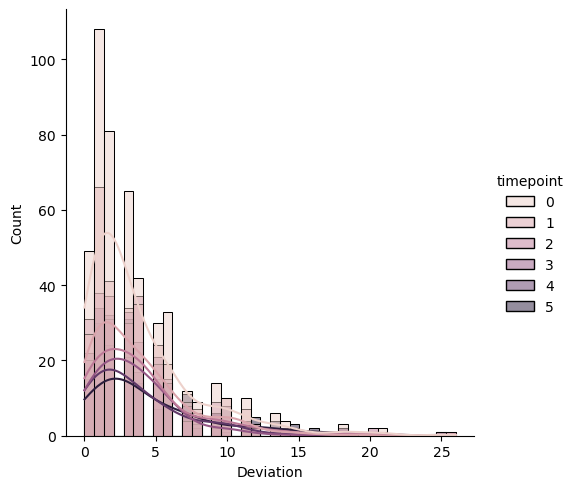

In [108]:
sns.displot(data, x='Deviation', hue='timepoint', kde=True)

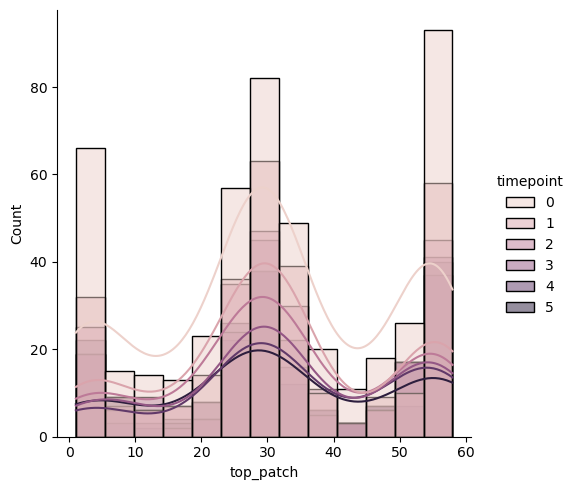

In [109]:
# data = pd.DataFrame(feature, columns=["Deviation", "patch_angle", "patch_time", "neighbor_angle", "neighbor_distance"])
sns.displot(data, x='top_patch', hue='timepoint', kde=True)
# plt.savefig("/media/wd/T7/data/distance.png")

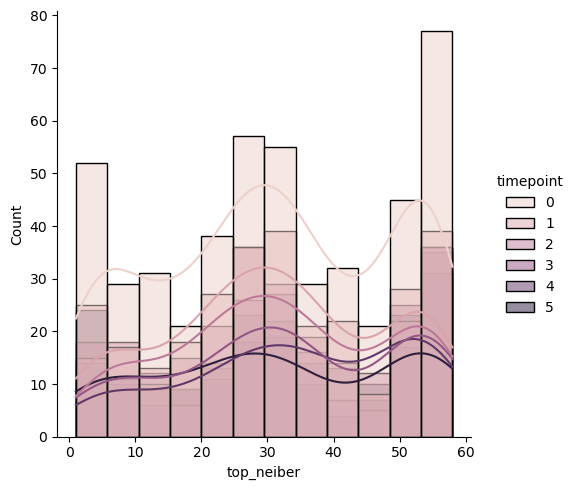

In [110]:
sns.displot(data, x='top_neiber', hue='timepoint', kde=True)

# plt.savefig("../org13.png")

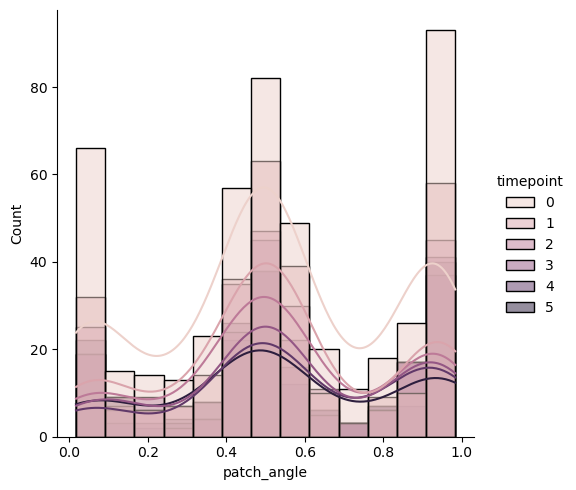

In [111]:
# sns.displot(data['patch_angle'], kde=True)
sns.displot(data, x='patch_angle', hue='timepoint', kde=True)
# plt.savefig("../org13.png")

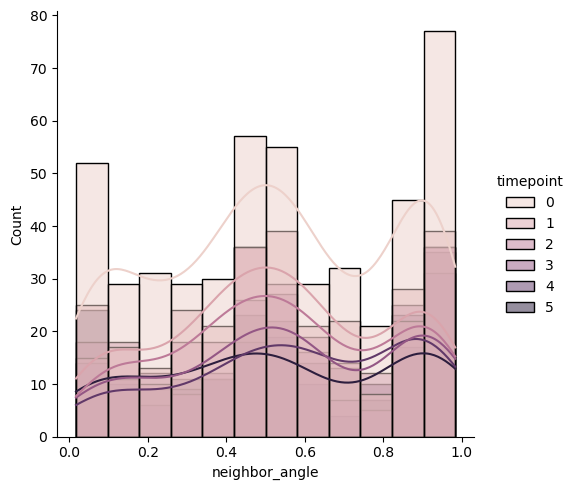

In [112]:
# sns.displot(data['neighbor_angle'], kde=True)
sns.displot(data, x='neighbor_angle', hue='timepoint', kde=True)

# plt.savefig("../org14.png")

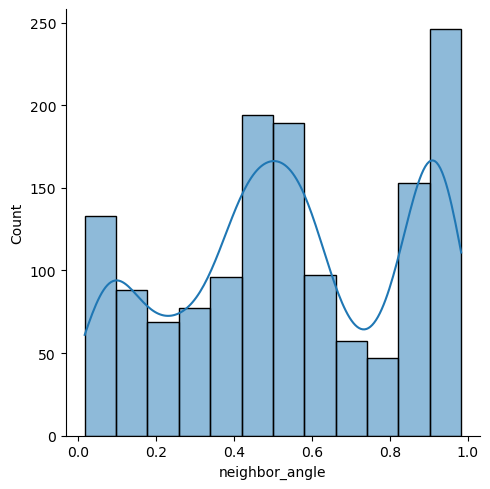

In [113]:
filted = data.loc[data["Deviation"]<10]
sns.displot(filted['neighbor_angle'], kde=True)

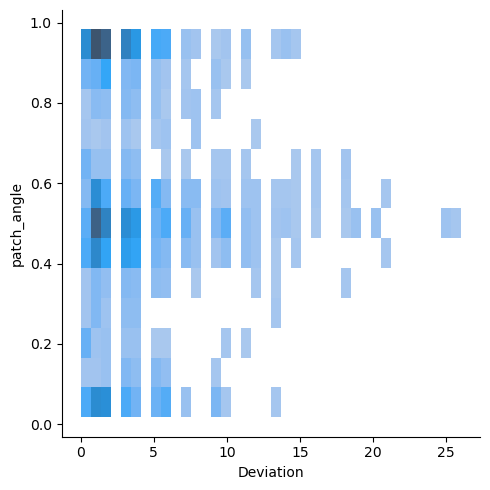

In [114]:
sns.displot(data, x="Deviation", y="patch_angle")
# plt.savefig("../org10.png")

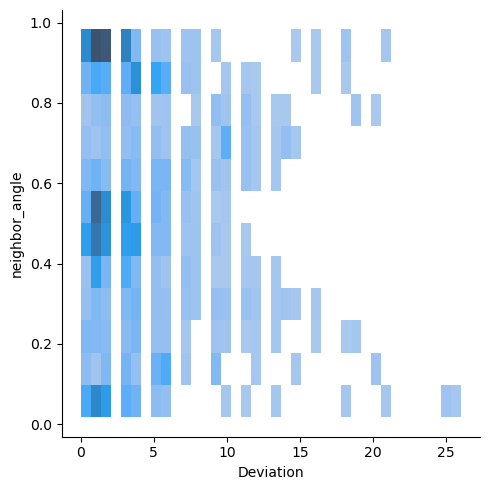

In [115]:
sns.displot(data, x="Deviation", y="neighbor_angle")
# plt.savefig("../org11.png")

In [116]:
from scipy import stats

In [117]:
heat_map_neibor = np.zeros([len(time_point), len(time_point)])
heat_map_patch = np.zeros([len(time_point), len(time_point)])

for i in range(0, heat_map_neibor.shape[0]):
    for j in range(0, heat_map_neibor.shape[1]):
        s,p = stats.ttest_ind(data[data.timepoint==i].neighbor_angle,
                              data[data.timepoint==j].neighbor_angle)
        heat_map_neibor[i,j] = p
        
        s,p = stats.ttest_ind(data[data.timepoint==i].patch_angle,
                              data[data.timepoint==j].patch_angle)
        heat_map_patch[i,j] = p

<Axes: >

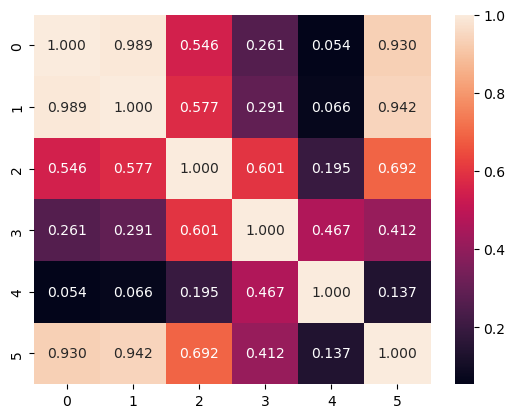

In [118]:
sns.heatmap(heat_map_neibor, annot=True, fmt=".3f")

<Axes: >

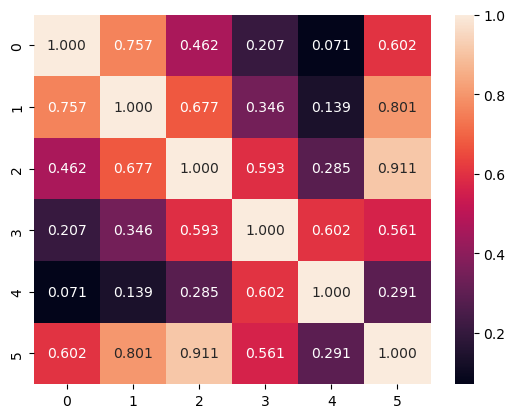

In [119]:
sns.heatmap(heat_map_patch,  annot=True, fmt=".3f")

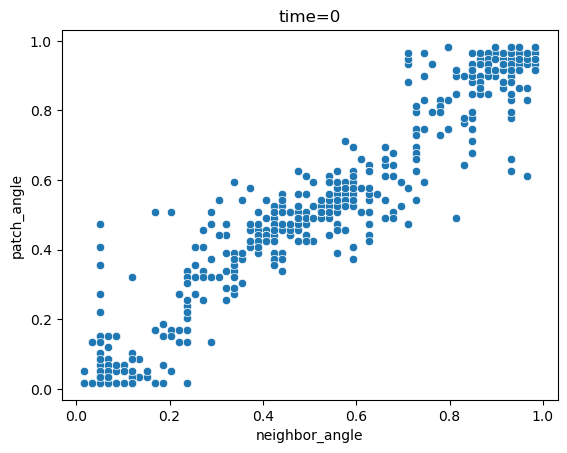

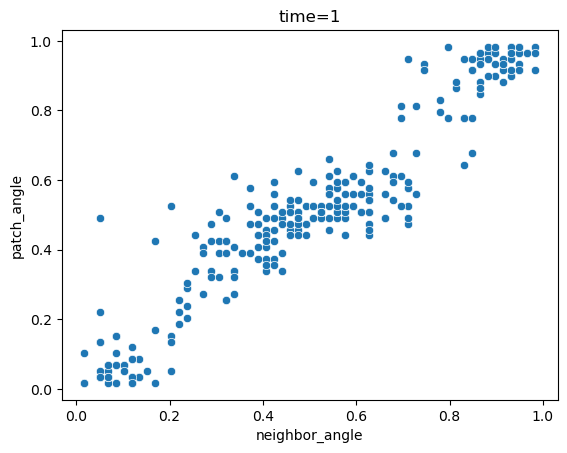

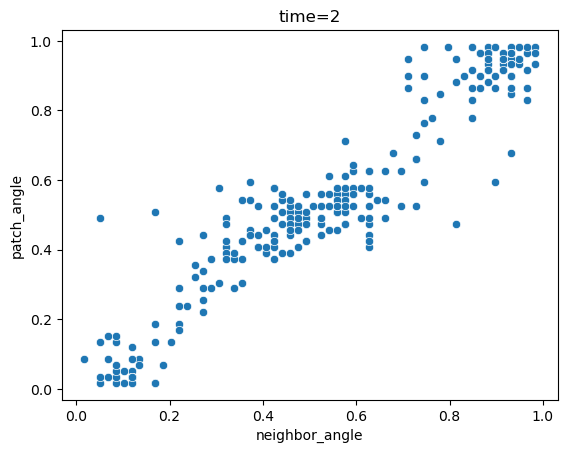

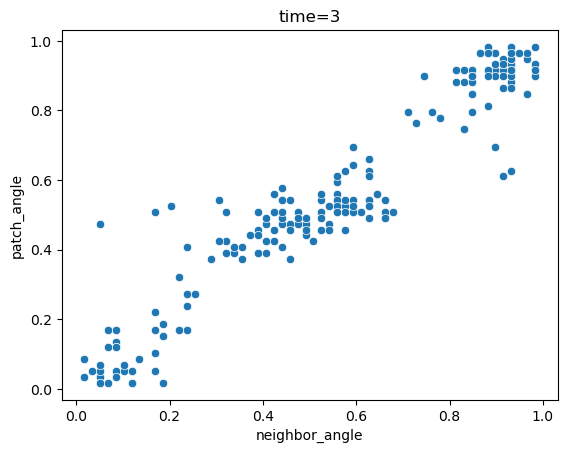

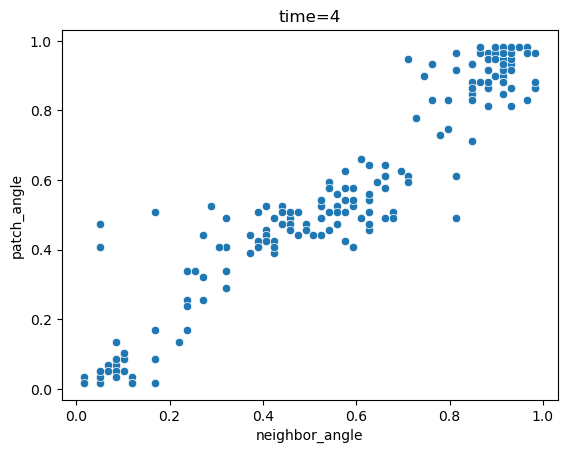

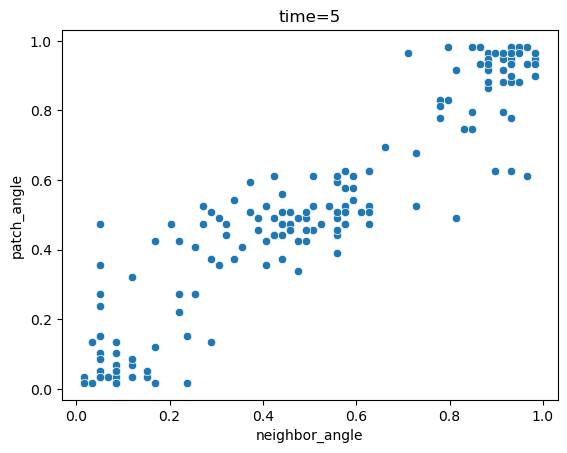

In [120]:
for t in range(0, len(time_point)):
    fig,ax = plt.subplots()
    sns.scatterplot(data[data.timepoint==t], x='neighbor_angle', y='patch_angle')
    plt.title(f"time={t}")

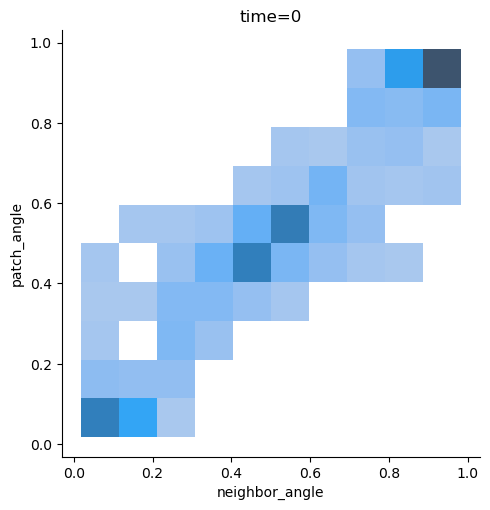

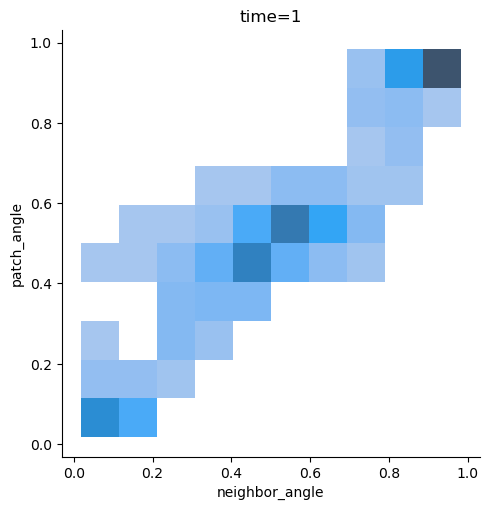

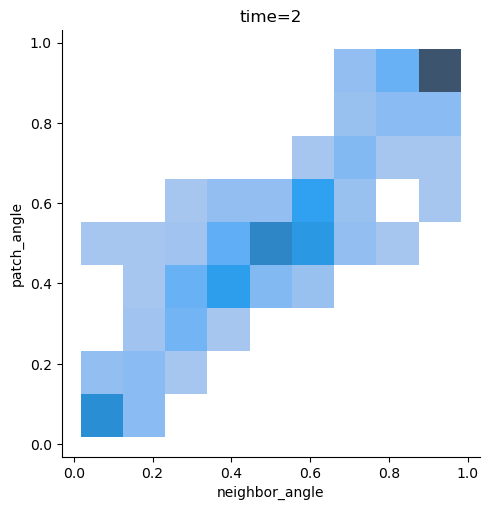

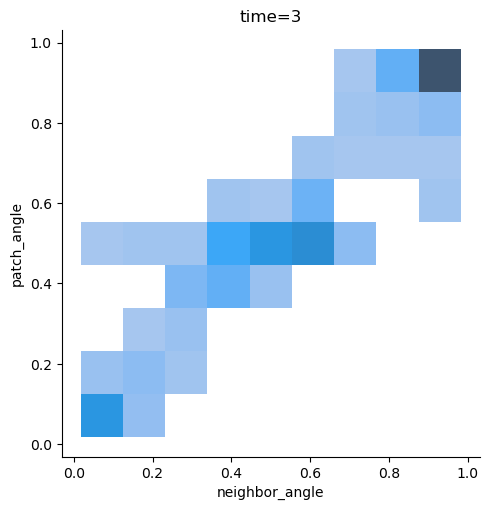

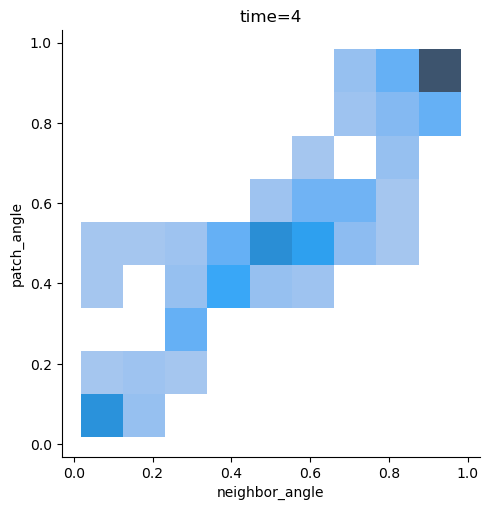

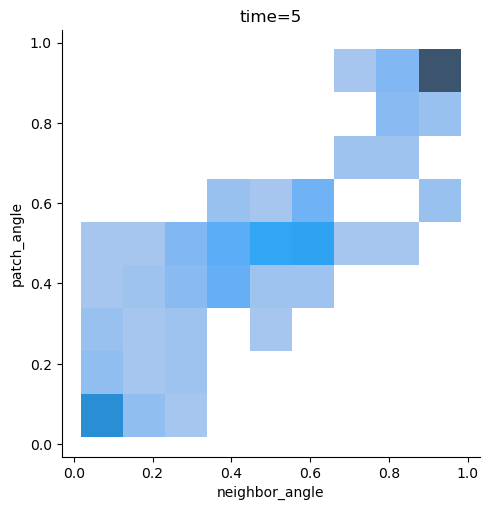

In [121]:
for t in range(0, len(time_point)):
    # fig,ax = plt.subplots()
    sns.displot(data[data.timepoint==t], x='neighbor_angle', y='patch_angle')
    plt.title(f"time={t}")

/home/wlli/miniconda3/envs/yeast/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


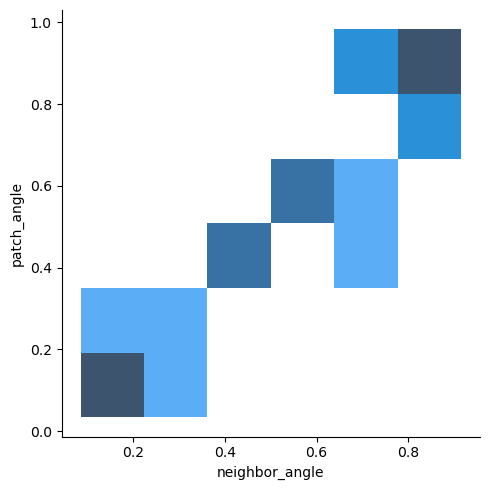

In [48]:
# sns.displot(data,x='neighbor_angle', y='patch_angle')
sns.displot(data[data.timepoint==0], x='neighbor_angle', y='patch_angle')
# plt.savefig("../org12.png")

/home/wlli/miniconda3/envs/yeast/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


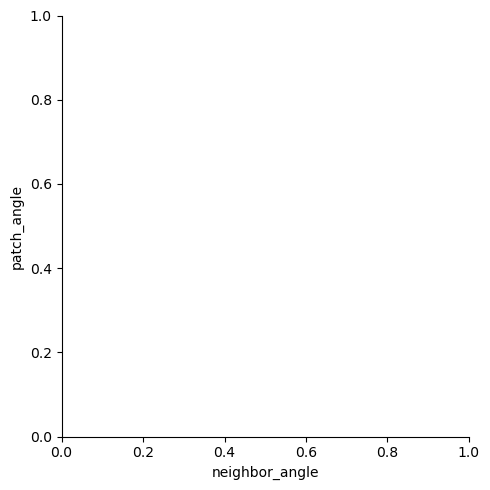

In [49]:
sns.displot(data[data.timepoint==50], x='neighbor_angle', y='patch_angle')

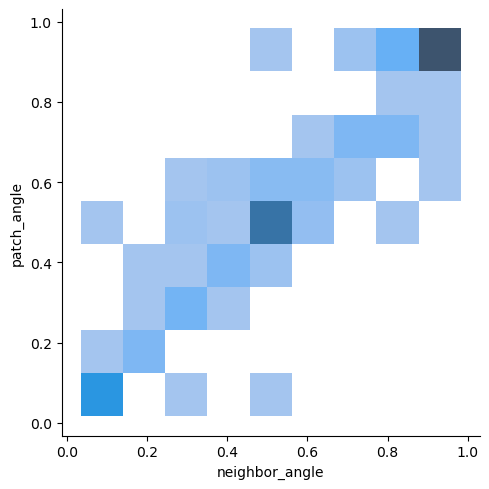

In [544]:
sns.displot(data[data.timepoint==100], x='neighbor_angle', y='patch_angle')


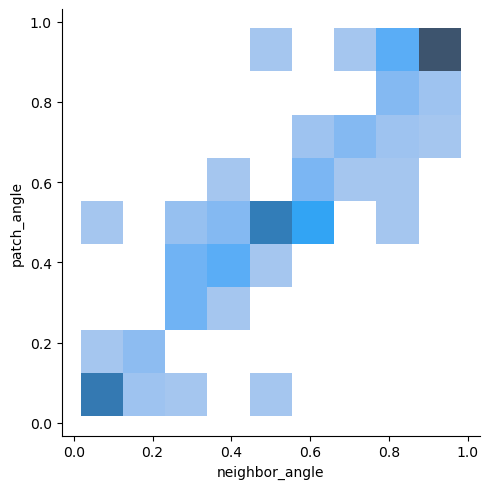

In [545]:
sns.displot(data[data.timepoint==150], x='neighbor_angle', y='patch_angle')


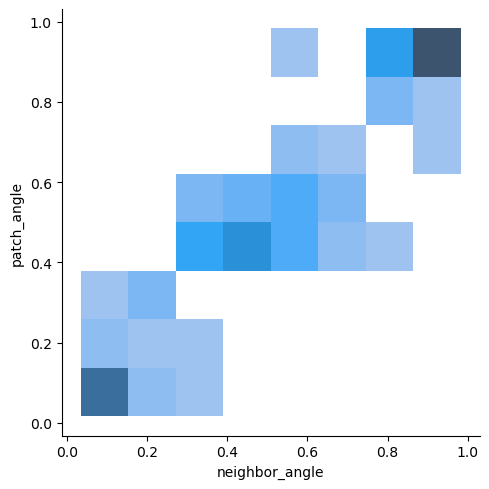

In [546]:
sns.displot(data[data.timepoint==200], x='neighbor_angle', y='patch_angle')


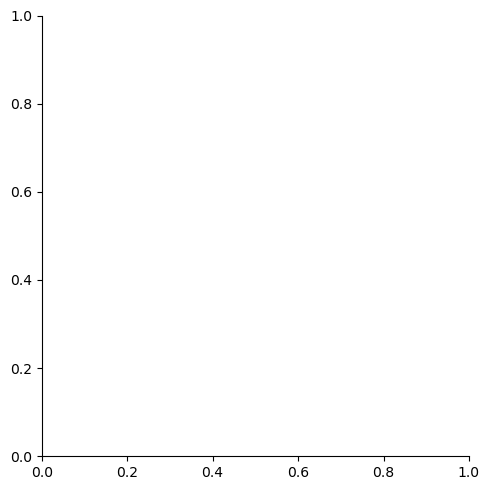

In [547]:
sns.displot(data[data.timepoint==250], x='neighbor_angle', y='patch_angle')


In [188]:
import random
postions = [0,1,2]
jumps = np.zeros((3,35))
f=0

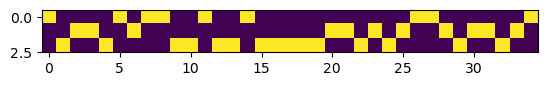

In [189]:
jumps = np.zeros((3,35))
for i in range(35):
    p = random.choices(postions)
    jumps[p, i] = 1
    f+=1
plt.imshow(jumps)
# plt.savefig(f"/home/wd/Pictures/random{f}.png")